In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import statsmodels.api as sm

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder, OrdinalEncoder, PolynomialFeatures
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.feature_selection import SelectFromModel

from yellowbrick.regressor import ResidualsPlot


In [2]:
plt.rcParams['figure.dpi']=500

In [3]:
df = pd.read_csv("CO2 Emissions_Canada.csv")
df.head().style.background_gradient(cmap = 'Blues', axis = 0)

,Make,Model,Vehicle Class,Engine Size(L),Cylinders,Transmission,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km)
0,ACURA,ILX,COMPACT,2.000000,4,AS5,Z,9.900000,6.700000,8.500000,33,196
1,ACURA,ILX,COMPACT,2.400000,4,M6,Z,11.200000,7.700000,9.600000,29,221
2,ACURA,ILX HYBRID,COMPACT,1.500000,4,AV7,Z,6.000000,5.800000,5.900000,48,136
3,ACURA,MDX 4WD,SUV - SMALL,3.500000,6,AS6,Z,12.700000,9.100000,11.100000,25,255
4,ACURA,RDX AWD,SUV - SMALL,3.500000,6,AS6,Z,12.100000,8.700000,10.600000,27,244


EDA 

In [4]:
# Check out the missing values

missing_count = df.isnull().sum()
value_count = df.isnull().count()
missing_percentage = round(missing_count / value_count * 100, 2)
missing_df = pd.DataFrame({"count": missing_count, "percentage": missing_percentage})
missing_df

,count,percentage
Make,0,0.0
Model,0,0.0
Vehicle Class,0,0.0
Engine Size(L),0,0.0
Cylinders,0,0.0
Transmission,0,0.0
Fuel Type,0,0.0
Fuel Consumption City (L/100 km),0,0.0
Fuel Consumption Hwy (L/100 km),0,0.0
Fuel Consumption Comb (L/100 km),0,0.0


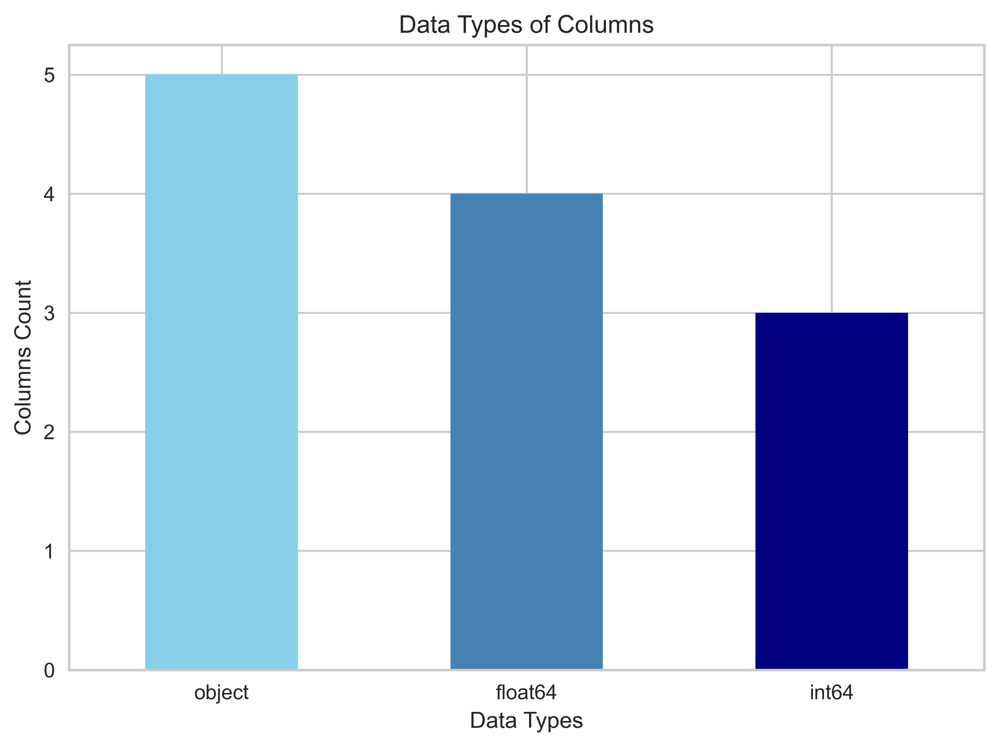

In [5]:
df.dtypes.value_counts().plot(kind='bar', color=['skyblue','steelblue', 'navy'])
plt.title('Data Types of Columns')
plt.xlabel('Data Types')
plt.ylabel('Columns Count')
plt.xticks(rotation=0)
plt.grid(True)
plt.show()

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Engine Size(L),7385.0,3.160068,1.354170,0.9,2.0,3.0,3.7,8.4
Cylinders,7385.0,5.615030,1.828307,3.0,4.0,6.0,6.0,16.0
Fuel Consumption City (L/100 km),7385.0,12.556534,3.500274,4.2,10.1,12.1,14.6,30.6
Fuel Consumption Hwy (L/100 km),7385.0,9.041706,2.224456,4.0,7.5,8.7,10.2,20.6
Fuel Consumption Comb (L/100 km),7385.0,10.975071,2.892506,4.1,8.9,10.6,12.6,26.1
Fuel Consumption Comb (mpg),7385.0,27.481652,7.231879,11.0,22.0,27.0,32.0,69.0
CO2 Emissions(g/km),7385.0,250.584699,58.512679,96.0,208.0,246.0,288.0,522.0


In [7]:
sns.pairplot(df,
             kind="reg",
             diag_kind="kde", 
             plot_kws={"line_kws": {"color": "red"}}
            )

In [8]:
numerical_df = df.drop(['Make', 'Model', 'Vehicle Class', 'Transmission', 'Fuel Type'], axis=1)

In [9]:
num_cols= df.select_dtypes('number').columns

skew_limit = 0.75               # define a limit above which we will log transform
skew_vals = df[num_cols].skew()

# Showing the skewed columns
skew_cols = (skew_vals
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))
skew_cols

,Skew
Cylinders,1.110415
Fuel Consumption Hwy (L/100 km),1.079217
Fuel Consumption Comb (mpg),0.977034
Fuel Consumption Comb (L/100 km),0.893316
Engine Size(L),0.809181
Fuel Consumption City (L/100 km),0.809005


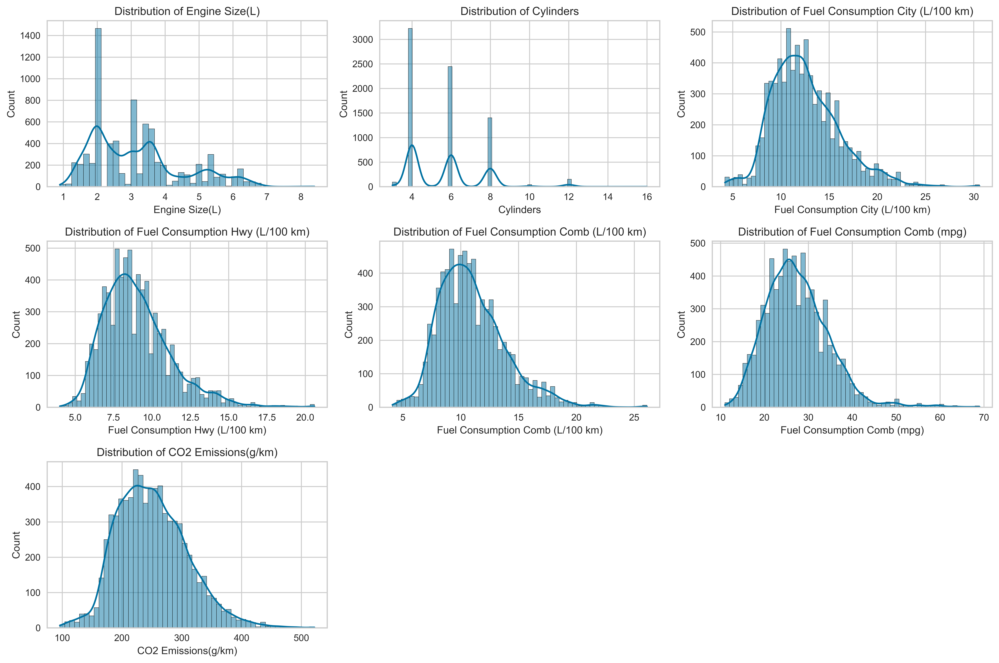

In [10]:

plt.figure(figsize=(15, 10))

num_vars = len(numerical_df.columns)

for i, var in enumerate(numerical_df.columns, 1):
    plt.subplot((num_vars // 3) + 1, 3, i)
    sns.histplot(data=df, x=var, kde=True)
    plt.title(f'Distribution of {var}')
    
plt.tight_layout()
plt.show()

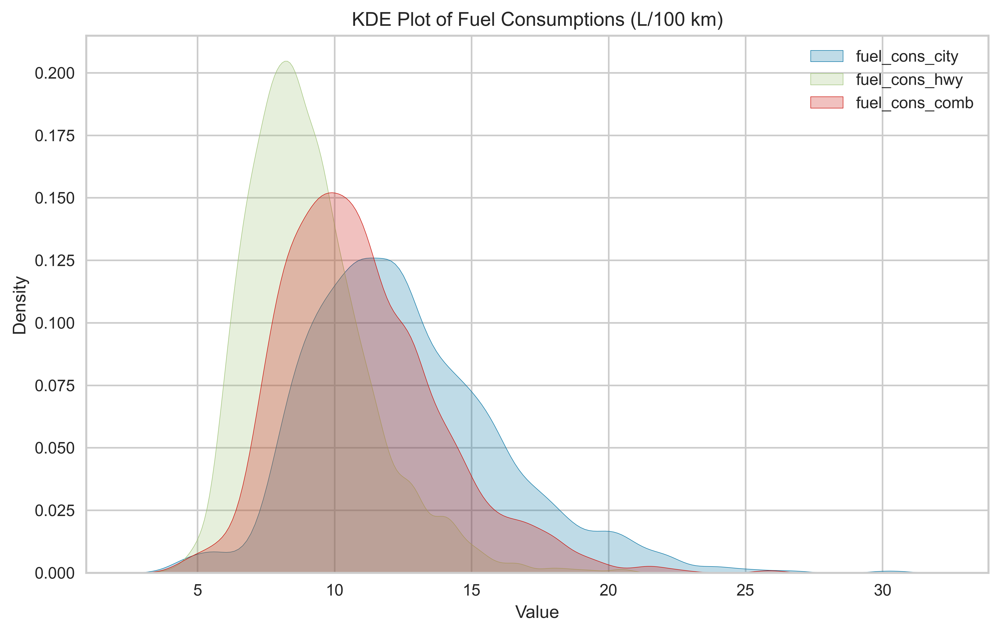

In [11]:
plt.figure(figsize=(10, 6))
sns.kdeplot(df['Fuel Consumption City (L/100 km)'], label='fuel_cons_city', fill=True)
sns.kdeplot(df['Fuel Consumption Hwy (L/100 km)'], label='fuel_cons_hwy', fill=True)
sns.kdeplot(df['Fuel Consumption Comb (L/100 km)'], label='fuel_cons_comb', fill=True)
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('KDE Plot of Fuel Consumptions (L/100 km)')
plt.legend()
plt.show()

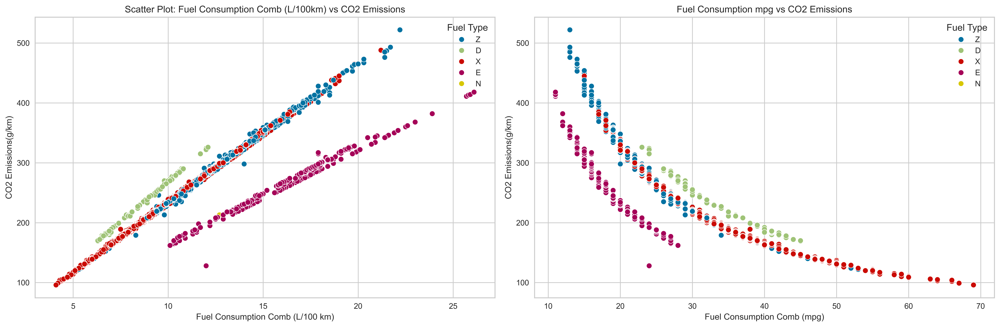

In [12]:
# สร้าง subplot 1 แถว 3 คอลัมน์
fig, axs = plt.subplots(1, 2, figsize=(18, 6))

# Scatter Plot ที่ 1: Fuel Consumption Hwy vs CO2 Emissions
sns.scatterplot(x='Fuel Consumption Comb (L/100 km)', y='CO2 Emissions(g/km)', hue='Fuel Type', data=df, ax=axs[0])
axs[0].set_title('Scatter Plot: Fuel Consumption Comb (L/100km) vs CO2 Emissions')

# Scatter Plot ที่ 2: Fuel Consumption City vs CO2 Emissions
sns.scatterplot(x='Fuel Consumption Comb (mpg)',y='CO2 Emissions(g/km)',hue='Fuel Type', data=df, ax=axs[1])
axs[1].set_title('Fuel Consumption mpg vs CO2 Emissions')


# แสดงกราฟ
plt.tight_layout()
plt.show()

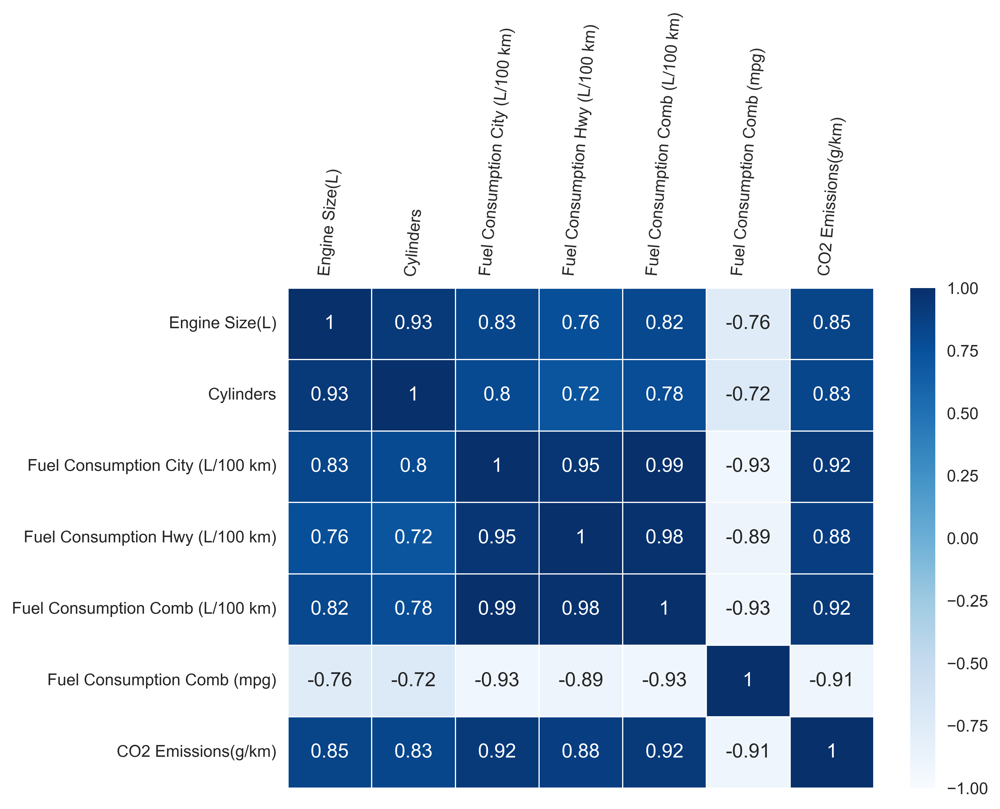

In [13]:
ax = sns.heatmap(numerical_df.corr(), vmin=-1, vmax=1, annot=True, cmap="Blues", linewidth=.5)
ax.set(xlabel="", ylabel="")
ax.xaxis.tick_top()
plt.xticks(rotation = 85)
plt.show() 

In [14]:
len(df['Make'].unique()), len(df['Model'].unique()), len(df['Vehicle Class'].unique()), len(df['Transmission'].unique())

(42, 2053, 16, 27)

Feature Selection by lasso regression

In [15]:
categorical_features = ['Make', 'Model', 'Vehicle Class', 'Transmission', 'Fuel Type']
numerical_features = [
    'Engine Size(L)', 'Cylinders', 'Fuel Consumption City (L/100 km)',
    'Fuel Consumption Hwy (L/100 km)', 'Fuel Consumption Comb (L/100 km)',
    'Fuel Consumption Comb (mpg)'
]

In [16]:
X = df.drop(['CO2 Emissions(g/km)'], axis=1)
y = df['CO2 Emissions(g/km)']

In [17]:
# สร้าง transformer สำหรับตัวแปรเชิงหมวดหมู่และเชิงปริมาณ
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ]
)

# สร้าง pipeline ที่ประกอบด้วย preprocessor และ Ridge Regression
lasso_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('feature_selector', SelectFromModel(Lasso(alpha=0.1))),
    ('lasso', Lasso(alpha=0.1))
])

# แบ่งข้อมูล train/test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train Ridge Regression พร้อมเลือก Feature ที่สำคัญ
lasso_pipeline.fit(X_train, y_train)


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Engine Size(L)',
                                                   'Cylinders',
                                                   'Fuel Consumption City '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Hwy '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(mpg)']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['Make', 'Model',
                                                   'Vehicle Class',
                                                   'Transmission',
                                                   'Fuel Type'])])),
                ('feature_selector',
                 SelectFromModel(estimator=Lasso(alpha=0.1))),
                ('lasso', Lasso(alpha=0.1))])

In [18]:

# ใช้ get_feature_names_out() เพื่อดูชื่อคอลัมน์ที่ผ่านการแปลง
transformed_feature_names = lasso_pipeline.named_steps['preprocessor'].get_feature_names_out()
selected_features_mask = lasso_pipeline.named_steps['feature_selector'].get_support()

# ดูว่า Feature ไหนถูกเลือก
selected_features = transformed_feature_names[selected_features_mask]

print("Important features:", selected_features)

Important features: ['num__Engine Size(L)' 'num__Cylinders'
 'num__Fuel Consumption City (L/100 km)'
 'num__Fuel Consumption Hwy (L/100 km)'
 'num__Fuel Consumption Comb (L/100 km)'
 'num__Fuel Consumption Comb (mpg)' 'cat__Make_FORD' 'cat__Fuel Type_D'
 'cat__Fuel Type_E']


In [19]:
is_cat_feature = np.array([('Fuel Type' in name or 'Transmission' in name) for name in selected_features])

selected_cat_features = selected_features[is_cat_feature]

print("Important categorical features:", selected_cat_features)

Important categorical features: ['cat__Fuel Type_D' 'cat__Fuel Type_E']


In [20]:
# ดึงค่า coefficients ของ Ridge ที่ถูกเลือกหลังจาก Feature Selection
ridge_coefficients = lasso_pipeline.named_steps['lasso'].coef_

# จับคู่ฟีเจอร์ที่ถูกเลือกกับค่า coefficient
important_features_with_coefficients = dict(zip(selected_features, ridge_coefficients))

for feature, coef in zip(selected_features, ridge_coefficients):
    print(f"Feature: {feature}, Coefficient: {coef}")

Feature: num__Engine Size(L), Coefficient: 0.6516127851936397
Feature: num__Cylinders, Coefficient: 2.4324193052458196
Feature: num__Fuel Consumption City (L/100 km), Coefficient: 35.84763381662723
Feature: num__Fuel Consumption Hwy (L/100 km), Coefficient: 19.454082902756134
Feature: num__Fuel Consumption Comb (L/100 km), Coefficient: 1.2378171817485035
Feature: num__Fuel Consumption Comb (mpg), Coefficient: -6.768016048625638
Feature: cat__Make_FORD, Coefficient: 0.41308236869601456
Feature: cat__Fuel Type_D, Coefficient: 25.81273072179212
Feature: cat__Fuel Type_E, Coefficient: -103.9416521674286


In [21]:
# ใช้ cross-validation เพื่อคำนวณ SE
lasso_cross_val_scores = cross_val_score(lasso_pipeline, X_train, y_train, cv=5)

# คำนวณ SE จากค่าเบี่ยงเบนมาตรฐานของคะแนน cross-validation
lasso_se = np.std(lasso_cross_val_scores)
print("Standard Error of the model:", lasso_se)

Standard Error of the model: 0.001329217463972145


In [22]:
lasso_fea_r2 = lasso_pipeline.score(X_test, y_test)
lasso_fea_pred = lasso_pipeline.predict(X_test)
lasso_fea_mae = mean_absolute_error(y_test, lasso_fea_pred)
lasso_fea_mse = mean_squared_error(y_test, lasso_fea_pred)

lasso_fea_r2

0.9910857480444231

In [23]:
lasso_train = lasso_pipeline.predict(X_train)
lasso_test = lasso_pipeline.predict(X_test)

lasso_mse_train = mean_squared_error(y_train, lasso_train)
lasso_mse_test = mean_squared_error(y_test, lasso_test)

lasso_mse_train, lasso_mse_test

(25.285897454721827, 30.66170540646207)

In [24]:
lasso_model = lasso_pipeline.named_steps['lasso']

print(f'Bias: {lasso_model.intercept_}')

Bias: 255.46466642123963


In [25]:
important_cat_list = {k: v for k, v in important_features_with_coefficients.items() if k.startswith('cat')}
important_cat_list = dict(sorted(important_cat_list.items(), key=lambda item: item[1], reverse=True))
important_cat_list

{'cat__Fuel Type_D': 25.81273072179212,
 'cat__Make_FORD': 0.41308236869601456,
 'cat__Fuel Type_E': -103.9416521674286}

In [26]:
df2 = df.drop(['Make','Model','Vehicle Class','Transmission'], axis=1)
df2.head(2)

,Engine Size(L),Cylinders,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km)
0,2.0,4,Z,9.9,6.7,8.5,33,196
1,2.4,4,Z,11.2,7.7,9.6,29,221


In [27]:
Fuel_typedict = df2['Fuel Type'].value_counts().to_dict()
Fuel_typedict

{'X': 3637, 'Z': 3202, 'E': 370, 'D': 175, 'N': 1}

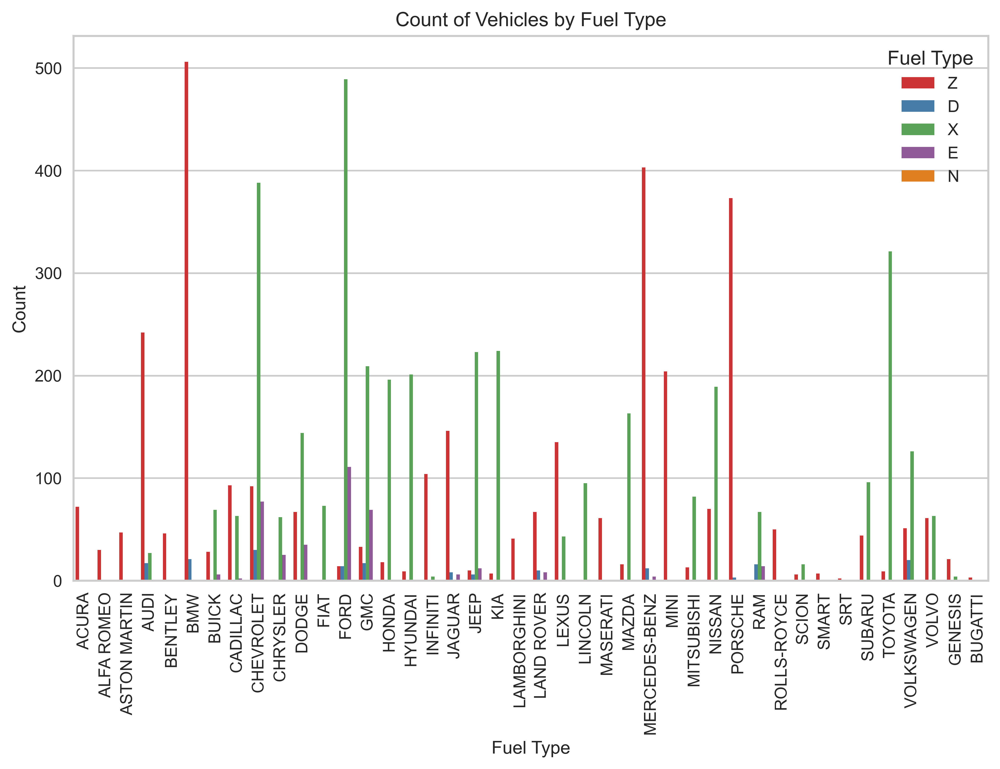

In [28]:
df["Make"].value_counts()

# สมมติว่า df คือ DataFrame ของคุณ
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Make', hue='Fuel Type', palette='Set1')

plt.title('Count of Vehicles by Fuel Type')
plt.xlabel('Fuel Type')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

Model

In [29]:
df3 = df.drop(categorical_features[0:4], axis=1)
df3.head()

,Engine Size(L),Cylinders,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km)
0,2.0,4,Z,9.9,6.7,8.5,33,196
1,2.4,4,Z,11.2,7.7,9.6,29,221
2,1.5,4,Z,6.0,5.8,5.9,48,136
3,3.5,6,Z,12.7,9.1,11.1,25,255
4,3.5,6,Z,12.1,8.7,10.6,27,244


In [30]:
# สร้าง transformer สำหรับตัวแปรเชิงหมวดหมู่และเชิงปริมาณ
preprocessor2 = ColumnTransformer(
    transformers=[
        ('num', Pipeline([
            ('scaler', StandardScaler()),
        ]), numerical_features),
        ('cy', OrdinalEncoder(), ['Cylinders']),
        ('cat', OneHotEncoder(handle_unknown='ignore'), ['Fuel Type'])
    ]
)


# สร้าง Pipeline สำหรับ Linear Regression
model_pipeline2 = Pipeline([
    ('preprocessor', preprocessor2),  # แปลงข้อมูลเชิงปริมาณ
    ('regressor', LinearRegression(fit_intercept=False))  # สร้างโมเดล Linear Regression
])

In [31]:
X2 = df3.drop(['CO2 Emissions(g/km)'], axis=1)
y2 = df3['CO2 Emissions(g/km)']

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [33]:
X_train.shape, y_train.shape

((5908, 7), (5908,))

In [34]:
model_pipeline2.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  ['Engine Size(L)',
                                                   'Cylinders',
                                                   'Fuel Consumption City '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Hwy '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(mpg)']),
                                                 ('cy', OrdinalEncoder(),
                                                  ['Cylinders']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['Fuel Type'])])),
                ('regressor', LinearRegression(fit_intercept=False))])

In [35]:
y_pred2 = model_pipeline2.predict(X_test)

In [36]:
linear_r2 = model_pipeline2.score(X_test, y_test)
linear_r2

0.9861103901422316

In [37]:
linear_rmse = np.sqrt(mean_squared_error(y_test, y_pred2))
linear_mse = mean_squared_error(y_test, y_pred2)
linear_mae = mean_absolute_error(y_test, y_pred2)
# ทำนายผลบน Test Set
print(f"Mean Absolute Error: {linear_mae:.2f}")
print(f'Mean Square Error: {linear_mse:.2f}')
print(f'Root Mean Square Error: {linear_rmse:.2f}')

Mean Absolute Error: 3.18
Mean Square Error: 47.78
Root Mean Square Error: 6.91


In [38]:
linear_train = model_pipeline2.predict(X_train)
linear_test = model_pipeline2.predict(X_test)

linear_mse_train = mean_squared_error(y_train, linear_train)
linear_mse_test = mean_squared_error(y_test, linear_test)

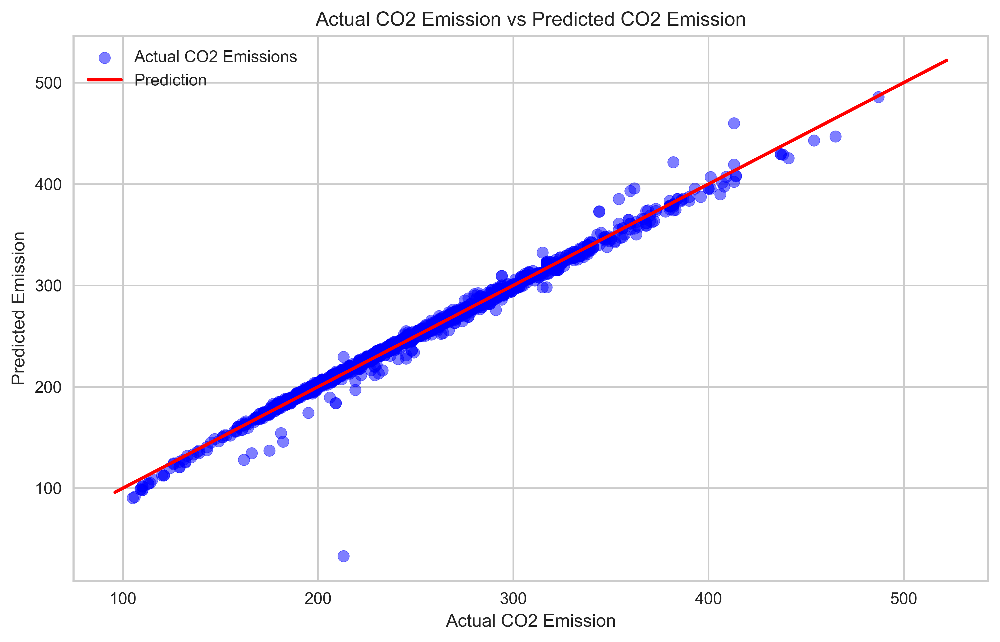

In [39]:
# วาดกราฟเปรียบเทียบราคาจริงและราคาที่คาดการณ์
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred2, color='blue', alpha=0.5,label='Actual CO2 Emissions')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='-' , lw=2, label='Prediction')
plt.title('Actual CO2 Emission vs Predicted CO2 Emission')
plt.xlabel('Actual CO2 Emission')
plt.ylabel('Predicted Emission')
plt.legend()
plt.grid(True)
plt.show()

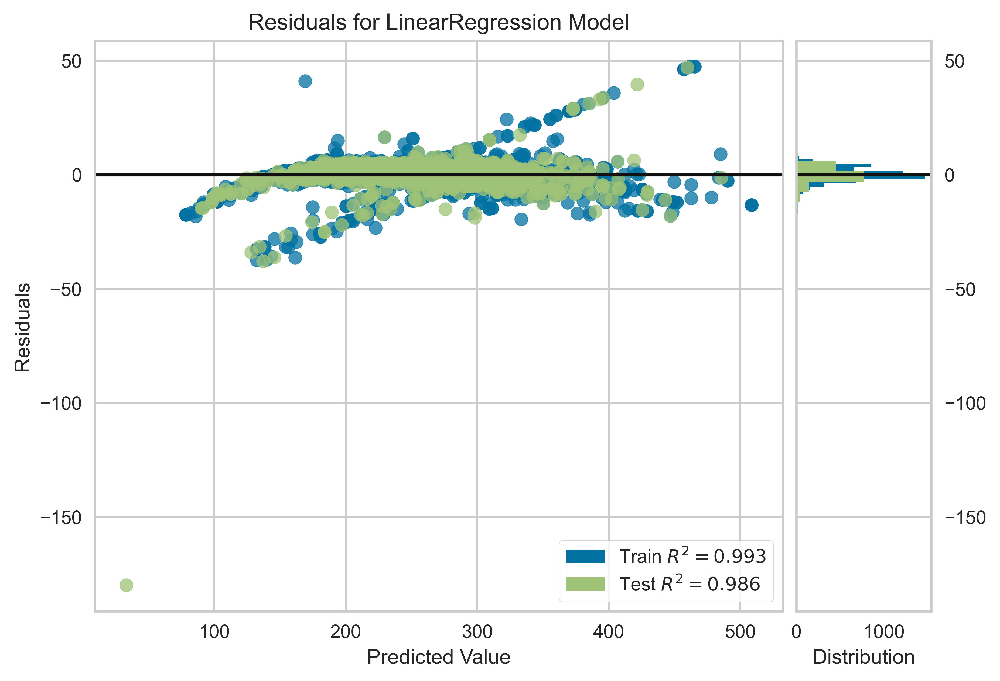

<Axes: title={'center': 'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [40]:
visualizer = ResidualsPlot(model_pipeline2)
visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()  

In [41]:
# Comparing Actual y_test, Predicted_y and Residuals
residuals = y_test - y_pred2

my_dict = {"Actual": y_test, "pred": y_pred2, "residual": residuals}
compare = pd.DataFrame(my_dict)
compare.head(20)

,Actual,pred,residual
7261,253,254.172581,-1.172581
4489,344,340.033109,3.966891
1539,322,325.351206,-3.351206
3532,297,297.873110,-0.873110
6418,308,306.342763,1.657237
3703,406,389.873482,16.126518
5976,242,243.301397,-1.301397
4332,216,217.413483,-1.413483
5015,246,245.333389,0.666611
2087,223,227.817159,-4.817159


In [42]:
li_feature_names2 = model_pipeline2.named_steps['preprocessor'].get_feature_names_out()

li_coefficients2 = pd.DataFrame({
    'Feature': li_feature_names2,
    'Coefficient': model_pipeline2.named_steps['regressor'].coef_
})

li_coefficients2.sort_values(by='Coefficient', ascending=False, inplace=True)
li_coefficients2

,Feature,Coefficient
7,cat__Fuel Type_D,291.135059
9,cat__Fuel Type_X,260.466053
10,cat__Fuel Type_Z,259.830027
8,cat__Fuel Type_E,152.403299
2,num__Fuel Consumption City (L/100 km),22.856571
4,num__Fuel Consumption Comb (L/100 km),21.786264
3,num__Fuel Consumption Hwy (L/100 km),12.748366
1,num__Cylinders,4.654296
0,num__Engine Size(L),0.407147
6,cy__Cylinders,-1.950353


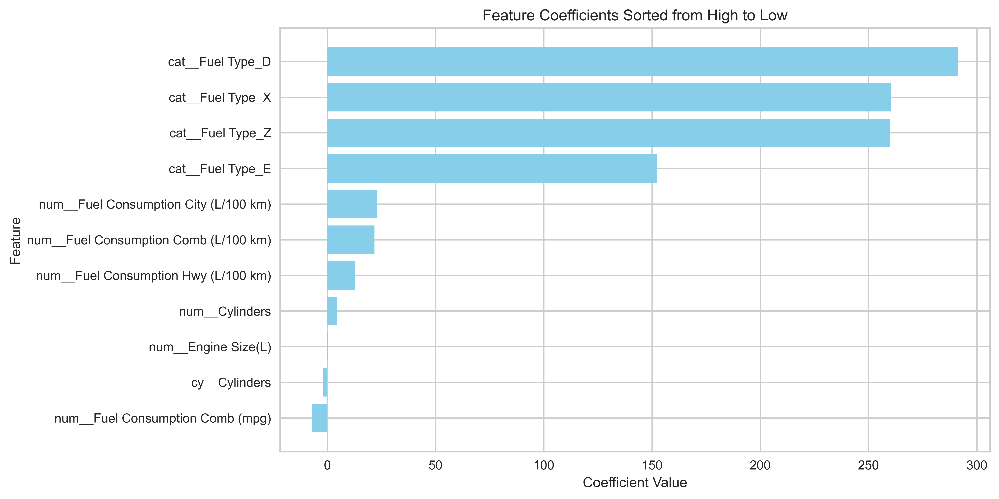

In [43]:
li_coefficients2.sort_values(by='Coefficient', ascending=False, inplace=True)

# Plot กราฟ
plt.figure(figsize=(10, 6))
plt.barh(li_coefficients2['Feature'], li_coefficients2['Coefficient'], color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients Sorted from High to Low')
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.gca().invert_yaxis()  # เพื่อให้ feature ที่มีค่า coefficient มากสุดอยู่บนสุด
plt.show()

In [44]:
# ใช้ cross-validation เพื่อคำนวณ SE
linear_cross_val_scores = cross_val_score(model_pipeline2, X_train, y_train, cv=5)

# คำนวณ SE จากค่าเบี่ยงเบนมาตรฐานของคะแนน cross-validation
linear_se = np.std(linear_cross_val_scores)
print("Standard Error of the model:", linear_se)

Standard Error of the model: 0.0013017805502864657


In [45]:
linear_model_bias = model_pipeline2.named_steps['regressor']

print(f'Bias: {linear_model_bias.intercept_}')

Bias: 0.0


Linear Regression + Polynomial degree 2

In [46]:
preprocessor_poly = ColumnTransformer(
    transformers=[
        ('num', Pipeline([
            ('scaler', StandardScaler()),
            ('poly', PolynomialFeatures(degree=2, include_bias=False))
        ]), numerical_features),
        ('cy', OrdinalEncoder(), ['Cylinders']),
        ('cat', OneHotEncoder(handle_unknown='ignore'), ['Fuel Type'])
    ]
)


poly_pipeline = Pipeline([
    ('preprocessor', preprocessor_poly),  
    ('regressor', LinearRegression(fit_intercept=False))  
])

In [47]:
poly_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler()),
                                                                  ('poly',
                                                                   PolynomialFeatures(include_bias=False))]),
                                                  ['Engine Size(L)',
                                                   'Cylinders',
                                                   'Fuel Consumption City '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Hwy '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(mpg)']),
                                                 ('cy', OrdinalEncoder(),
                                                  ['Cylinders']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['Fuel Type'])])),
                ('regressor', LinearRegression(fit_intercept=False))])

In [48]:
poly_pred = poly_pipeline.predict(X_test)
linear_poly1_rmse = np.sqrt(mean_squared_error(y_test, poly_pred))
linear_poly1_mse = mean_squared_error(y_test, poly_pred)
linear_poly1_mae = mean_absolute_error(y_test, poly_pred)
linear_poly1_r2 = poly_pipeline.score(X_test, y_test)
print(f'score R^2: {linear_poly1_r2}')
print()
print(f'mean absolute error: {linear_poly1_mae:.2f}')
print(f'mean square error: {linear_poly1_mse:.2f}')
print(f'Root mean square error: {linear_poly1_rmse:.2f}')

score R^2: 0.9899367289579056

mean absolute error: 2.66
mean square error: 34.61
Root mean square error: 5.88


In [49]:
poly1_train = poly_pipeline.predict(X_train)
poly1_test = poly_pipeline.predict(X_test)

poly1_mse_train = mean_squared_error(y_train, poly1_train)
poly1_mse_test = mean_squared_error(y_test, poly1_test)

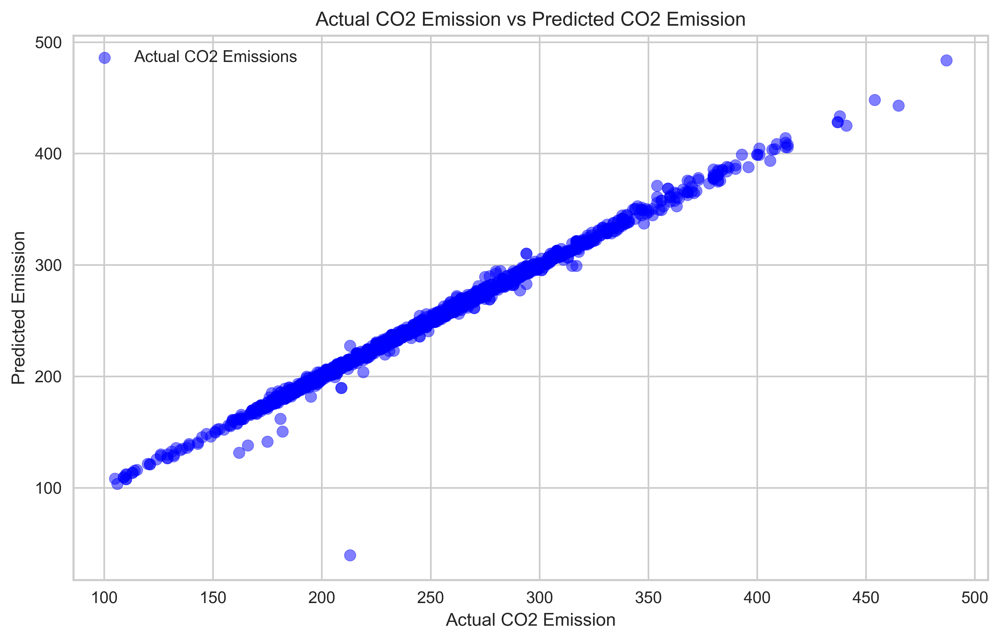

In [50]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, poly_pred, color='blue', alpha=0.5,label='Actual CO2 Emissions')
# plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='-' , lw=2, label='Prediction')
plt.title('Actual CO2 Emission vs Predicted CO2 Emission')
plt.xlabel('Actual CO2 Emission')
plt.ylabel('Predicted Emission')
plt.legend()
plt.grid(True)
plt.show()

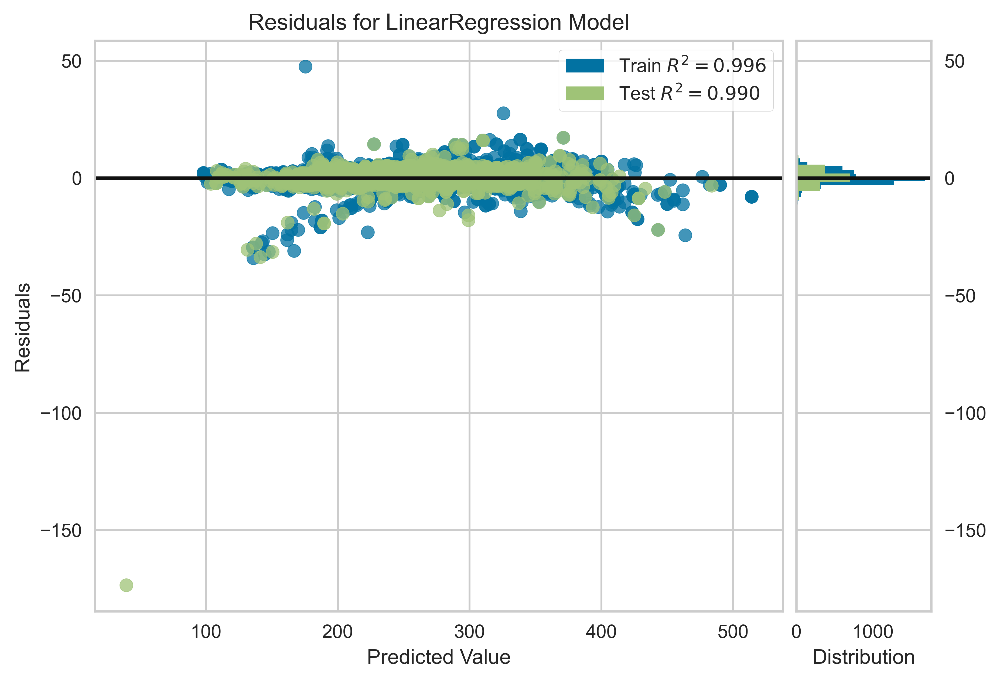

<Axes: title={'center': 'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [51]:
visualizer = ResidualsPlot(poly_pipeline)
visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()

In [52]:
poly_coef_feature = poly_pipeline.named_steps['preprocessor'].get_feature_names_out()

poly_coef_feature = pd.DataFrame({
    'Feature': poly_coef_feature,
    'Coefficient': poly_pipeline.named_steps['regressor'].coef_
})

poly_coef_feature.sort_values(by='Coefficient', ascending=False, inplace=True)
poly_coef_feature.reset_index(drop=True)

,Feature,Coefficient
0,cat__Fuel Type_D,288.547585
1,cat__Fuel Type_X,256.972096
2,cat__Fuel Type_Z,256.316615
3,cat__Fuel Type_E,151.241520
4,num__Fuel Consumption City (L/100 km)^2,94.358439
5,num__Fuel Consumption Comb (L/100 km)^2,84.472782
6,num__Fuel Consumption City (L/100 km) Fuel Con...,63.751164
7,num__Fuel Consumption City (L/100 km) Fuel Con...,36.261864
8,num__Fuel Consumption Comb (L/100 km),32.319582
9,num__Fuel Consumption City (L/100 km),25.490639


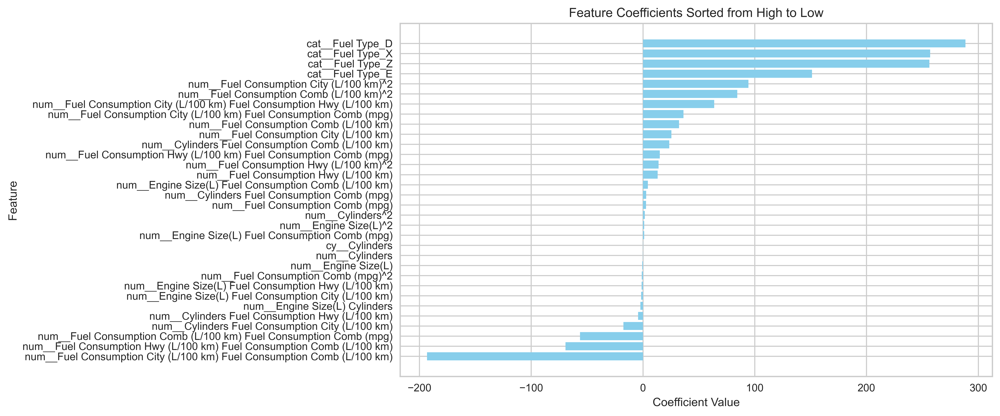

In [53]:
# Plot กราฟ
plt.figure(figsize=(10, 6))
plt.barh(poly_coef_feature['Feature'], poly_coef_feature['Coefficient'], color='skyblue')
plt.xlabel('Coefficient Value')
plt.title('Feature Coefficients Sorted from High to Low')
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.gca().invert_yaxis()  # เพื่อให้ feature ที่มีค่า coefficient มากสุดอยู่บนสุด
plt.show()

In [54]:
poly1_model_bias = poly_pipeline.named_steps['regressor']

print(f'Bias: {poly1_model_bias.intercept_}')

Bias: 0.0


In [55]:
# ใช้ cross-validation เพื่อคำนวณ SE
linear_poly1_cross_val_scores = cross_val_score(poly_pipeline, X_train, y_train, cv=5)

# คำนวณ SE จากค่าเบี่ยงเบนมาตรฐานของคะแนน cross-validation
linear_poly1 = np.std(linear_poly1_cross_val_scores)
print("Standard Error of the model:", linear_poly1)

Standard Error of the model: 0.00044545679521569424


KNN Regressor

In [56]:
from sklearn.neighbors import KNeighborsRegressor

pre = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cy', OrdinalEncoder(), ['Cylinders']),
        ('cat', OneHotEncoder(handle_unknown='ignore'), ['Fuel Type'])
    ]
)

knn_pipeline = Pipeline([
    ('preprocessor', pre),
    ('knn', KNeighborsRegressor(n_neighbors=5))
])

In [57]:
# ฝึกฝนโมเดล
knn_pipeline.fit(X_train, y_train)

# ทำนายค่าจากชุดทดสอบ
y_pred_knn = knn_pipeline.predict(X_test)
knn_rmse = np.sqrt(mean_squared_error(y_test, y_pred_knn))
knn_mse = mean_squared_error(y_test, y_pred_knn)
knn_mae = mean_absolute_error(y_test, y_pred_knn)
knn_r2 = knn_pipeline.score(X_test, y_test)
print(f'Score R^2: {knn_r2}')
print()
print(f"Mean Absolute Error: {knn_mae:.2f}")
print(f'Mean Square Error: {knn_mse:.2f}')
print(f'Root Mean Square Error: {knn_rmse:.2f}')

Score R^2: 0.9952264121673654

Mean Absolute Error: 2.38
Mean Square Error: 16.42
Root Mean Square Error: 4.05


In [58]:
knn_train = knn_pipeline.predict(X_train)
knn_test = knn_pipeline.predict(X_test)

knn_mse_train = mean_squared_error(y_train, knn_train)
knn_mse_test = mean_squared_error(y_test, knn_test)

knn_mse_train, knn_mse_test

(8.258469871360866, 16.41936357481381)

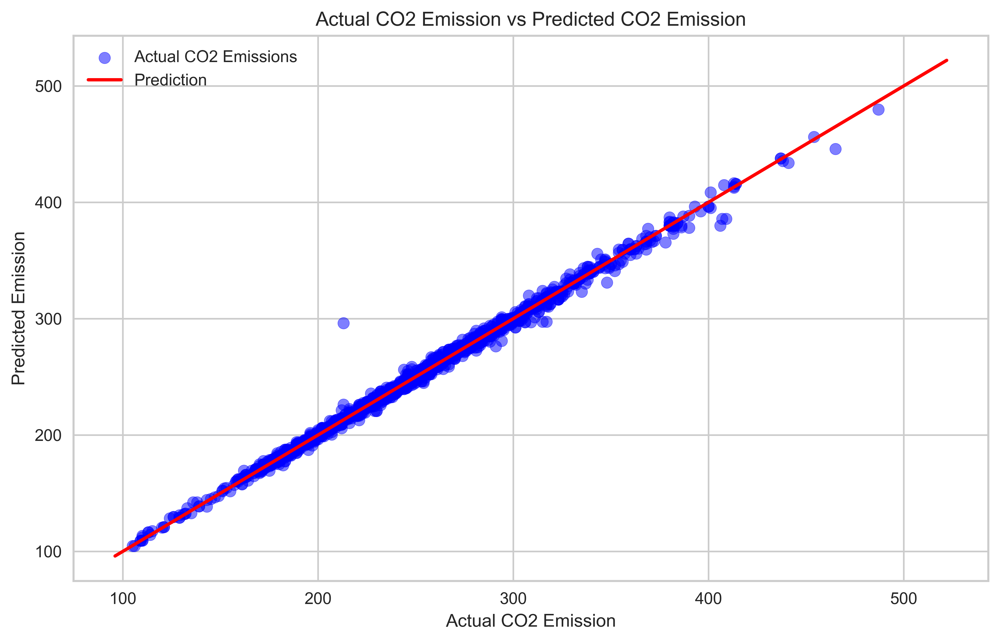

In [59]:
# วาดกราฟเปรียบเทียบราคาจริงและราคาที่คาดการณ์
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_knn, color='blue', alpha=0.5,label='Actual CO2 Emissions')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='-' , lw=2, label='Prediction')
plt.title('Actual CO2 Emission vs Predicted CO2 Emission')
plt.xlabel('Actual CO2 Emission')
plt.ylabel('Predicted Emission')
plt.legend()
plt.grid(True)
plt.show()

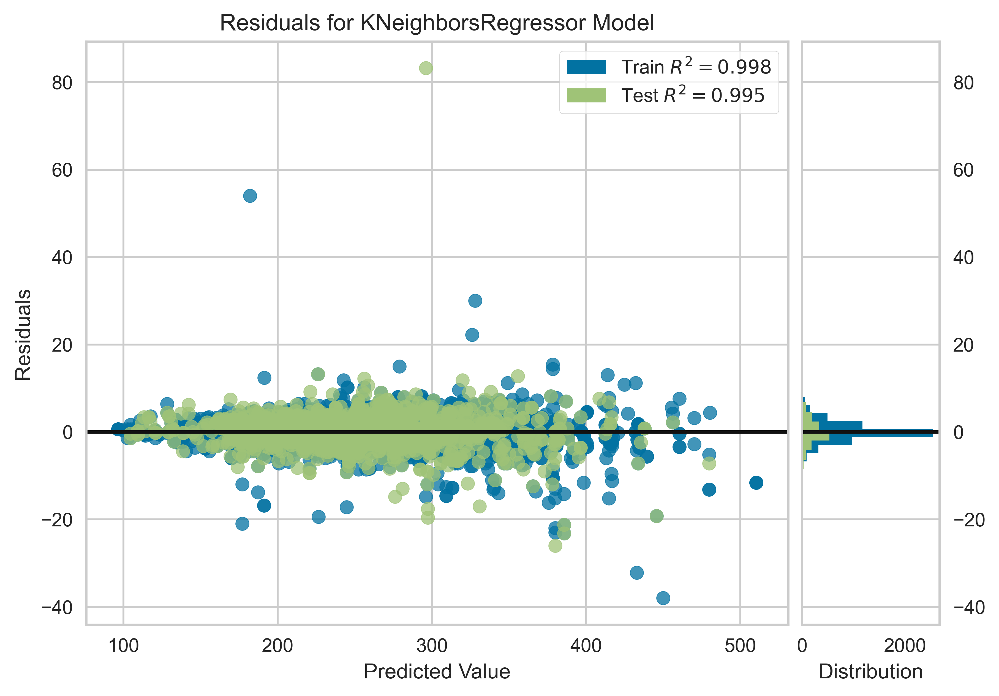

<Axes: title={'center': 'Residuals for KNeighborsRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [60]:
visualizer = ResidualsPlot(knn_pipeline)
visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()  

In [61]:
from sklearn.inspection import permutation_importance
# Permutation Importance
perm_importance = permutation_importance(knn_pipeline, X_test, y_test, scoring='neg_mean_squared_error', random_state=42)

# แสดงความสำคัญของฟีเจอร์
feature_importance = perm_importance.importances_mean
print("Feature Importance:", feature_importance)

Feature Importance: [ 61.39280162 378.57264184 521.19578605 425.8432715  460.42351794
 471.41485714 479.98041435]


In [62]:
# ดึงชื่อคอลัมน์จาก X_test
column_names = X_test.columns if isinstance(X_test, pd.DataFrame) else [f"Feature {i}" for i in range(X_test.shape[1])]

# สร้าง DataFrame จาก feature_importance
importance_df = pd.DataFrame({
    'Feature': column_names,
    'Importance': feature_importance
}).sort_values(by='Importance', ascending=False)

# แสดง DataFrame
importance_df

,Feature,Importance
2,Fuel Type,521.195786
6,Fuel Consumption Comb (mpg),479.980414
5,Fuel Consumption Comb (L/100 km),471.414857
4,Fuel Consumption Hwy (L/100 km),460.423518
3,Fuel Consumption City (L/100 km),425.843271
1,Cylinders,378.572642
0,Engine Size(L),61.392802


C:\Users\BM MONEY\AppData\Local\Temp\ipykernel_20124\1545509348.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')


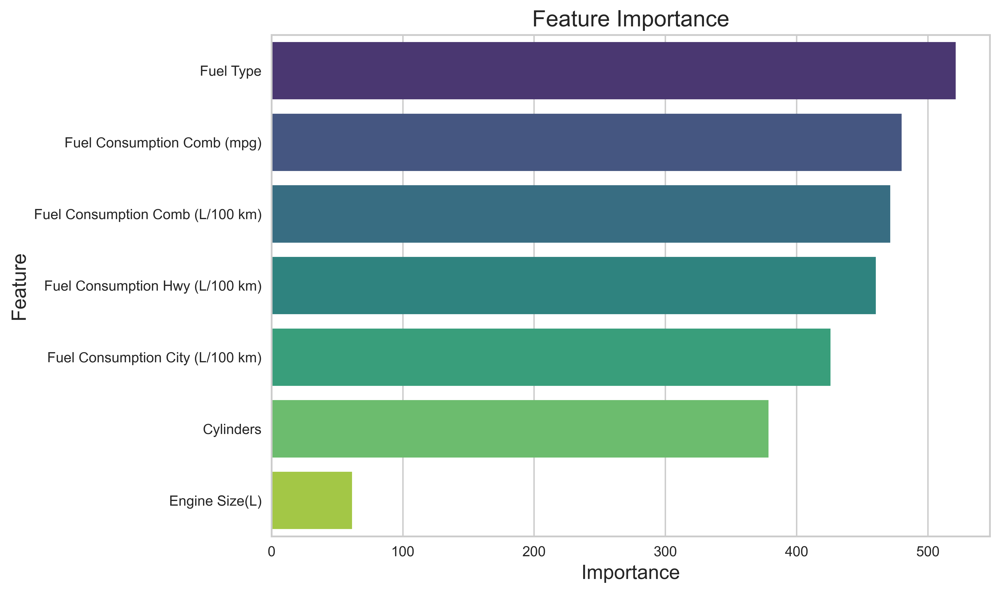

In [63]:
# Plot Feature Importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')

# ปรับแต่งกราฟ
plt.title('Feature Importance', fontsize=16)
plt.xlabel('Importance', fontsize=14)
plt.ylabel('Feature', fontsize=14)
plt.tight_layout()

# แสดงกราฟ
plt.show()

In [64]:
# ใช้ cross-validation เพื่อคำนวณ SE
knn1cross_val_scores = cross_val_score(knn_pipeline, X_train, y_train, cv=5)

# คำนวณ SE จากค่าเบี่ยงเบนมาตรฐานของคะแนน cross-validation
knn1_se = np.std(knn1cross_val_scores)
print("Standard Error of the model:", knn1_se)

Standard Error of the model: 0.0004185152573502226


In [65]:
knn_model_bias = knn_pipeline.named_steps['knn']
print(knn_model_bias.get_params())

{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}


Compare Residuals

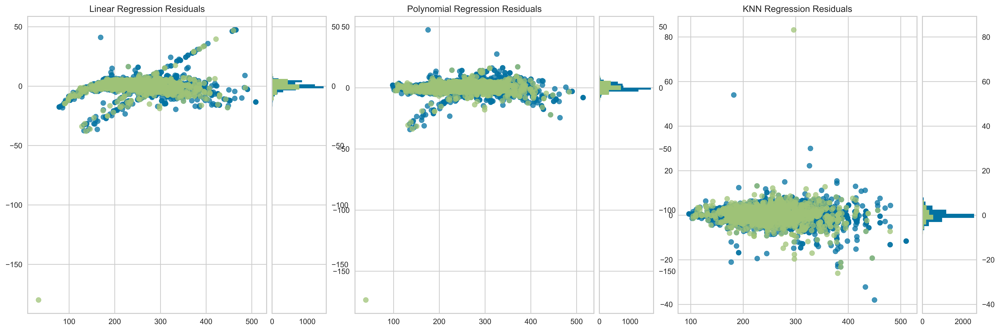

In [66]:
# สร้าง figure และกำหนด layout subplot
fig, axes = plt.subplots(1, 3, figsize=(18, 6), constrained_layout=True)

# Residuals Plot สำหรับ model_pipeline2
visualizer1 = ResidualsPlot(model_pipeline2, ax=axes[0])
visualizer1.fit(X_train, y_train)  # Fit the training data
visualizer1.score(X_test, y_test)  # Evaluate the model on the test data
axes[0].set_title("Linear Regression Residuals")

# Residuals Plot สำหรับ poly_pipeline
visualizer2 = ResidualsPlot(poly_pipeline, ax=axes[1])
visualizer2.fit(X_train, y_train)  # Fit the training data
visualizer2.score(X_test, y_test)  # Evaluate the model on the test data
axes[1].set_title("Polynomial Regression Residuals")

# Residuals Plot สำหรับ knn_pipeline
visualizer3 = ResidualsPlot(knn_pipeline, ax=axes[2])
visualizer3.fit(X_train, y_train)  # Fit the training data
visualizer3.score(X_test, y_test)  # Evaluate the model on the test data
axes[2].set_title("KNN Regression Residuals")

# แสดงกราฟ
plt.show()

Fuel Type

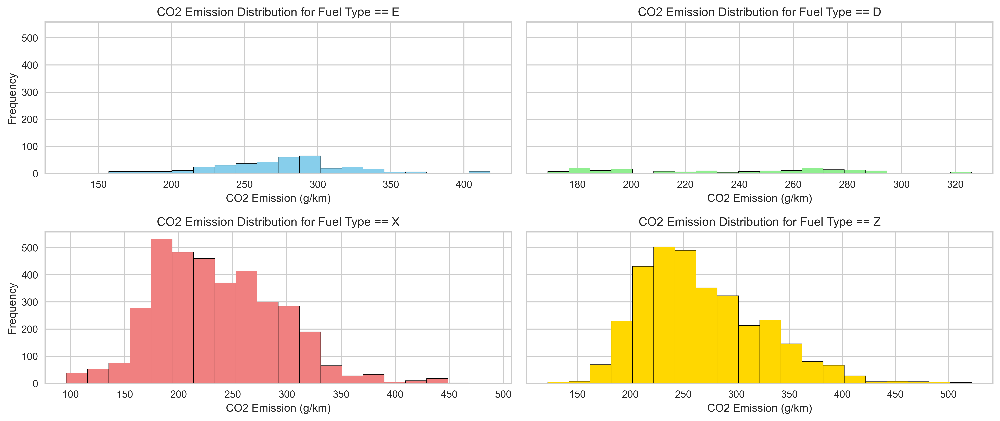

In [68]:
# Filter ข้อมูลสำหรับ Fuel Type E และ D
filtered_data_e = df[df['Fuel Type'] == 'E']
filtered_data_d = df[df['Fuel Type'] == 'D']
filtered_data_x = df[df['Fuel Type'] == 'X']
filtered_data_z = df[df['Fuel Type'] == 'Z']

# ดึงค่า CO2 Emissions
co2_emission_e = filtered_data_e['CO2 Emissions(g/km)']
co2_emission_d = filtered_data_d['CO2 Emissions(g/km)']
co2_emission_x = filtered_data_x['CO2 Emissions(g/km)']
co2_emission_z = filtered_data_z['CO2 Emissions(g/km)']

# สร้าง subplot
fig, axes = plt.subplots(2, 2, figsize=(14, 6), sharey=True)

# Subplot สำหรับ Fuel Type E
axes[0, 0].hist(co2_emission_e, bins=20, color='skyblue', edgecolor='black')
axes[0, 0].set_xlabel('CO2 Emission (g/km)')
axes[0, 0].set_ylabel('Frequency')
axes[0, 0].set_title('CO2 Emission Distribution for Fuel Type == E')

# Subplot สำหรับ Fuel Type D
axes[0, 1].hist(co2_emission_d, bins=20, color='lightgreen', edgecolor='black')
axes[0, 1].set_xlabel('CO2 Emission (g/km)')
axes[0, 1].set_title('CO2 Emission Distribution for Fuel Type == D')

# Subplot สำหรับ Fuel Type X
axes[1, 0].hist(co2_emission_x, bins=20, color='lightcoral', edgecolor='black')
axes[1, 0].set_xlabel('CO2 Emission (g/km)')
axes[1, 0].set_ylabel('Frequency')
axes[1, 0].set_title('CO2 Emission Distribution for Fuel Type == X')

# Subplot สำหรับ Fuel Type Z
axes[1, 1].hist(co2_emission_z, bins=20, color='gold', edgecolor='black')
axes[1, 1].set_xlabel('CO2 Emission (g/km)')
axes[1, 1].set_title('CO2 Emission Distribution for Fuel Type == Z')

# จัด layout
plt.tight_layout()
plt.show()

Pipeline Function

In [73]:
# # Define a function to preprocess and train the model
# def train_pipeline(data, target, test_size=0.2, random_state=42, alpha=1.0):
#     X = data
#     y = target

#     # Split the data
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

#     # Define and fit the pipeline
#     pipeline = Pipeline([
#         ('preprocessor', ColumnTransformer(
#             transformers=[
#                 ('num', StandardScaler(), X.columns)
#                 # ('num', Pipeline([
#                 #     ('scaler', StandardScaler()),
#                 #     ('poly', PolynomialFeatures(degree=2))
#                 # ]), X.columns)
#             ]
#         )),
#         ('regressor', Ridge(alpha=alpha))
#     ])

#     pipeline.fit(X_train, y_train)
#     return pipeline, X_train, X_test, y_test

# # Call the function for both data_hwy and data_city
# # model_pipeline3, X_train4, X_test4, y_test4 = train_pipeline(df4.drop(['CO2 Emissions(g/km)'], axis=1), df4['CO2 Emissions(g/km)'])


Compare Comb, Hwy, City by Fuel Type and Fuel Consumption

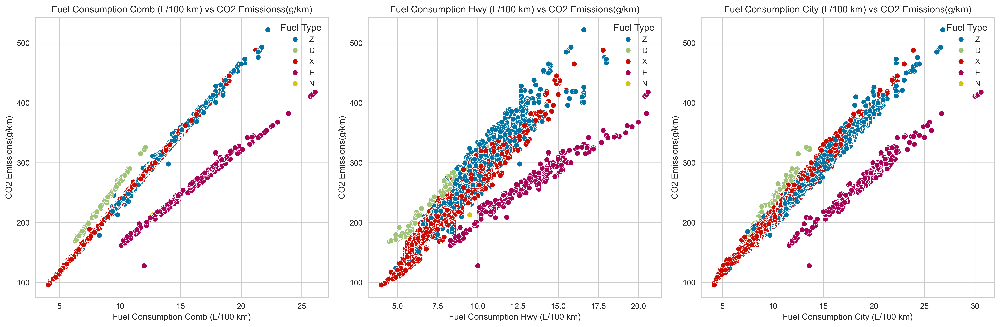

In [70]:
# สร้าง subplot 1 แถว 3 คอลัมน์
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Scatter Plot ที่ 1: Fuel Consumption Hwy vs CO2 Emissions
sns.scatterplot(x='Fuel Consumption Comb (L/100 km)', y='CO2 Emissions(g/km)', hue='Fuel Type', data=df, ax=axs[0])
axs[0].set_title('Fuel Consumption Comb (L/100 km) vs CO2 Emissionss(g/km)')

# Scatter Plot ที่ 2: Fuel Consumption City vs CO2 Emissions
sns.scatterplot(x='Fuel Consumption Hwy (L/100 km)', y='CO2 Emissions(g/km)', hue='Fuel Type', data=df, ax=axs[1])
axs[1].set_title('Fuel Consumption Hwy (L/100 km) vs CO2 Emissions(g/km)')

# Scatter Plot ที่ 3: Fuel Consumption Comb vs CO2 Emissions
sns.scatterplot(x='Fuel Consumption City (L/100 km)', y='CO2 Emissions(g/km)', hue='Fuel Type', data=df, ax=axs[2])
axs[2].set_title('Fuel Consumption City (L/100 km) vs CO2 Emissions(g/km)')

# แสดงกราฟ
plt.tight_layout()
plt.show()

Fuel Type

In [71]:
thwy_e = df[df['Fuel Type'] == 'E']
thwy_e

,Make,Model,Vehicle Class,Engine Size(L),Cylinders,Transmission,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km)
145,BUICK,LACROSSE,MID-SIZE,3.6,6,AS6,E,18.4,12.2,15.6,18,250
147,BUICK,LACROSSE AWD,MID-SIZE,3.6,6,AS6,E,19.4,13.0,16.5,17,264
180,CADILLAC,ESCALADE AWD,SUV - STANDARD,6.2,8,A6,E,23.3,16.1,20.1,14,322
182,CADILLAC,ESCALADE ESV AWD,SUV - STANDARD,6.2,8,A6,E,25.7,17.8,22.1,13,354
206,CHEVROLET,EQUINOX,SUV - SMALL,3.6,6,A6,E,18.8,13.1,16.2,17,259
...,...,...,...,...,...,...,...,...,...,...,...,...
6879,GMC,Sierra 4WD FFV,PICKUP TRUCK - STANDARD,5.3,8,A6,E,21.8,16.8,19.5,14,325
6892,GMC,Yukon FFV,SUV - STANDARD,5.3,8,A6,E,21.2,13.9,17.9,16,298
6895,GMC,Yukon 4WD FFV,SUV - STANDARD,5.3,8,A6,E,21.7,14.3,18.4,15,305
6899,GMC,Yukon XL FFV,SUV - STANDARD,5.3,8,A6,E,21.2,13.9,17.9,16,298


In [72]:
(thwy_e['CO2 Emissions(g/km)'].min(), thwy_e['CO2 Emissions(g/km)'].max())

(128, 418)

K-Means

In [73]:
from sklearn.cluster import KMeans

data_k = df[df["Fuel Type"] == "E"]

# 2. แปลงคอลัมน์ 'Make' ให้เป็นตัวเลขด้วย LabelEncoder
encoder = LabelEncoder()
data_k['Make_Encoded'] = encoder.fit_transform(data_k['Make'])

K_X = data_k[['Make_Encoded', 'CO2 Emissions(g/km)']]

kmeans = KMeans(n_clusters=2, random_state=42)
data_k['Cluster'] = kmeans.fit_predict(K_X)

# 5. ระบุว่ากลุ่มไหนปล่อย CO2 สูง/ต่ำ
cluster_means = data_k.groupby('Cluster')['CO2 Emissions(g/km)'].mean()
low_co2_cluster = cluster_means.idxmin()  # Cluster ที่ปล่อย CO2 ต่ำ
high_co2_cluster = cluster_means.idxmax()  # Cluster ที่ปล่อย CO2 สูง

data_k['CO2_Group'] = data_k['Cluster'].apply(
    lambda x: 'Low CO2' if x == low_co2_cluster else 'High CO2'
)

# 6. ดูผลลัพธ์
print(data_k[['Make', 'CO2 Emissions(g/km)', 'CO2_Group']].head())

C:\Users\BM MONEY\AppData\Local\Temp\ipykernel_20124\3184248345.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_k['Make_Encoded'] = encoder.fit_transform(data_k['Make'])
c:\Users\BM MONEY\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


          Make  CO2 Emissions(g/km) CO2_Group
145      BUICK                  250   Low CO2
147      BUICK                  264   Low CO2
180   CADILLAC                  322  High CO2
182   CADILLAC                  354  High CO2
206  CHEVROLET                  259   Low CO2


C:\Users\BM MONEY\AppData\Local\Temp\ipykernel_20124\3184248345.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_k['Cluster'] = kmeans.fit_predict(K_X)
C:\Users\BM MONEY\AppData\Local\Temp\ipykernel_20124\3184248345.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_k['CO2_Group'] = data_k['Cluster'].apply(


In [74]:
from sklearn.metrics import silhouette_score

# คำนวณ Silhouette Score
silhouette_avg = silhouette_score(K_X, data_k['Cluster'])
print(f"Silhouette Score: {silhouette_avg:.2f}")

Silhouette Score: 0.54


In [75]:
data_k["Fuel Consumption Comb (L/100 km)"].median()

17.1

In [76]:
data_k_gret = data_k[data_k["Fuel Consumption Comb (L/100 km)"] > data_k["Fuel Consumption Comb (L/100 km)"].median()]
data_k_less = data_k[data_k["Fuel Consumption Comb (L/100 km)"] <= data_k["Fuel Consumption Comb (L/100 km)"].median()]

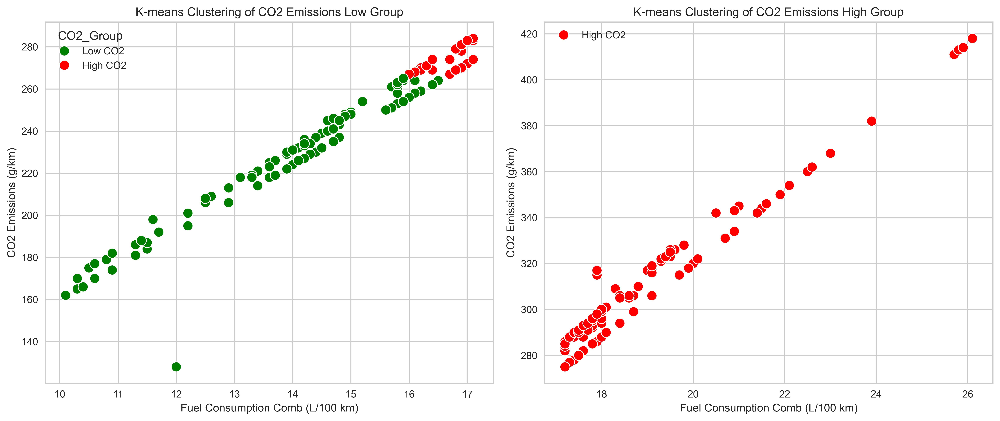

In [77]:
# 6. Plot แบบ 1 แถว 2 คอลัมน์
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Plot 1: Scatter Plot with CO2 Group
sns.scatterplot(x='Fuel Consumption Comb (L/100 km)', y='CO2 Emissions(g/km)', data=data_k_less, hue='CO2_Group', palette={'Low CO2': 'green', 'High CO2': 'red'}, s=100, ax=axes[0])
axes[0].set_title("K-means Clustering of CO2 Emissions Low Group")
axes[0].set_xlabel("Fuel Consumption Comb (L/100 km)")
axes[0].set_ylabel("CO2 Emissions (g/km)")

# Plot 2: Scatter Plot with Centroids
sns.scatterplot(x='Fuel Consumption Comb (L/100 km)', y='CO2 Emissions(g/km)', data=data_k_gret, hue='CO2_Group', palette={'High CO2' : 'red'}, s=100, ax=axes[1])
axes[1].set_title("K-means Clustering of CO2 Emissions High Group")
axes[1].set_xlabel("Fuel Consumption Comb (L/100 km)")
axes[1].set_ylabel("CO2 Emissions (g/km)")


# แสดง legend
axes[1].legend()

plt.tight_layout()
plt.show()

In [78]:
check_high_in_less = data_k_less[data_k_less["CO2_Group"] == "High CO2"]
check_high_in_less.head(2)

,Make,Model,Vehicle Class,Engine Size(L),Cylinders,Transmission,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km),Make_Encoded,Cluster,CO2_Group
209,CHEVROLET,EQUINOX AWD,SUV - SMALL,3.6,6,A6,E,19.8,13.6,17.0,17,272,2,1,High CO2
238,CHEVROLET,SILVERADO,PICKUP TRUCK - STANDARD,4.3,6,A6,E,18.9,14.2,16.8,17,269,2,1,High CO2


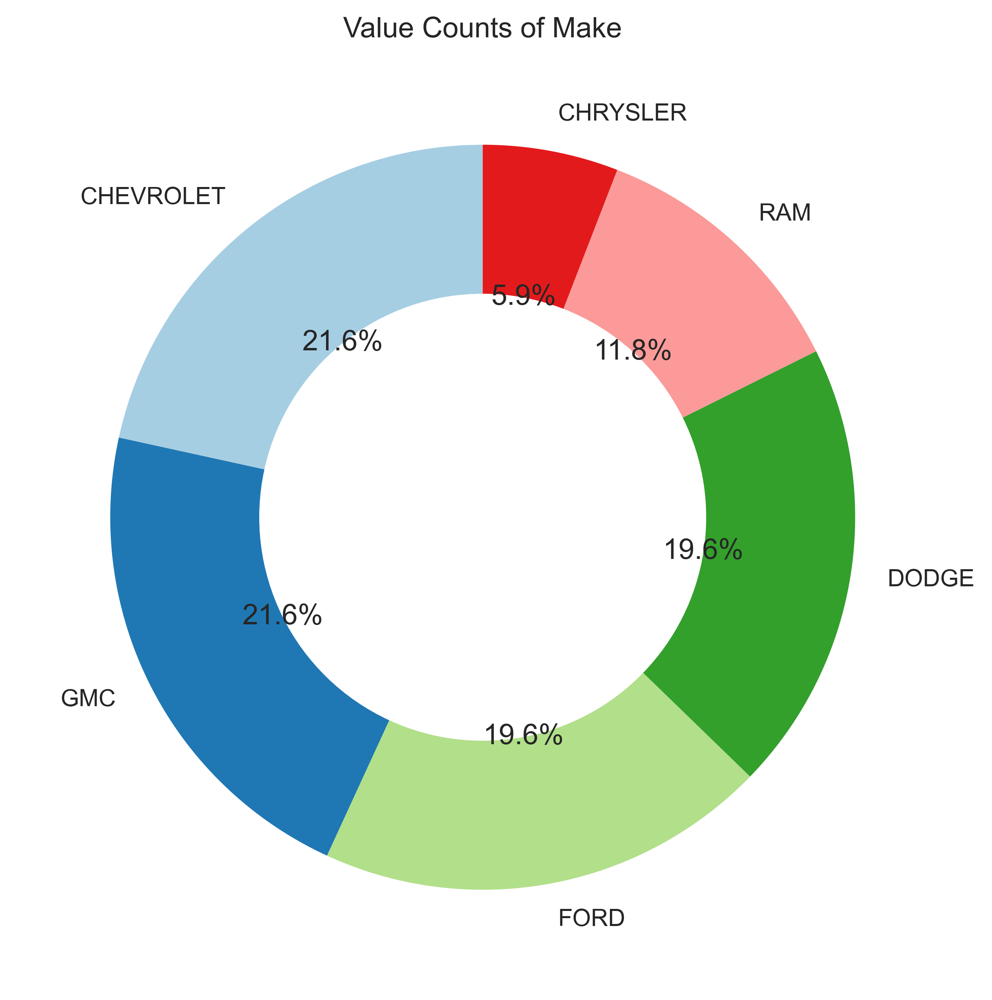

In [79]:
# Get the value counts
value_counts_c = check_high_in_less['Make'].value_counts()

# Plot Donut Chart
plt.figure(figsize=(10, 6))
plt.pie(value_counts_c, labels=value_counts_c.index, autopct='%1.1f%%', startangle=90, 
        colors=plt.cm.Paired.colors, wedgeprops={'width': 0.4})  # width = 0.4 ทำให้เป็น donut shape

# ตั้งชื่อกราฟ
plt.title('Value Counts of Make')

# แสดงกราฟ
plt.tight_layout()
plt.show()

In [80]:
check_high_plot = check_high_in_less[[
    "Make", "Vehicle Class", "Fuel Type", 
    "Fuel Consumption Comb (L/100 km)", "CO2 Emissions(g/km)", "CO2_Group"
]]

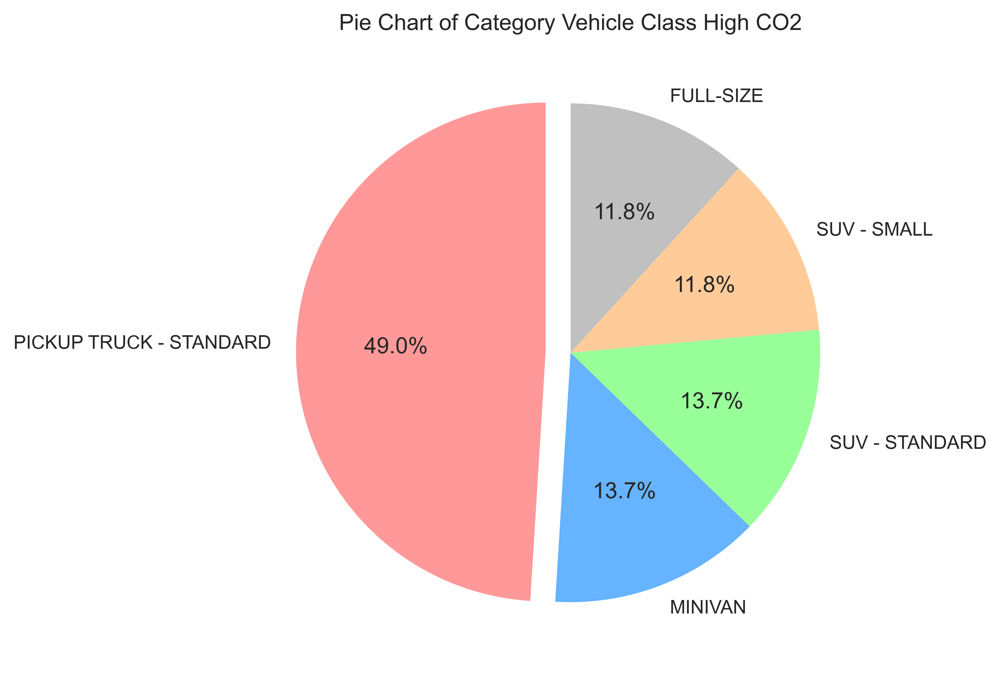

In [81]:
# นับความถี่ของแต่ละ Category
value_counts_v = check_high_in_less['Vehicle Class'].value_counts()
color_template = ['#FF9999', '#66B3FF', '#99FF99', '#FFCC99', '#C0C0C0']


# Plot pie chart
plt.figure(figsize=(8, 6))
value_counts_v.plot.pie(
    autopct='%1.1f%%',  # แสดงเปอร์เซ็นต์ในแต่ละส่วน
    startangle=90,      # หมุนให้เริ่มจากมุม 90 องศา
    colors=color_template[:len(value_counts_v)],  # กำหนดสี
    labels=value_counts_v.index,  # กำหนด label เป็นชื่อ Category
    explode=[0.1 if i == value_counts_v.idxmax() else 0 for i in value_counts_v.index],  # แยกส่วนที่ค่ามากที่สุด
)
plt.title('Pie Chart of Category Vehicle Class High CO2')
plt.ylabel('')  # ลบ label แกน Y
plt.show()

In [82]:
truck = check_high_plot[check_high_plot["Vehicle Class"] == "PICKUP TRUCK - STANDARD"]

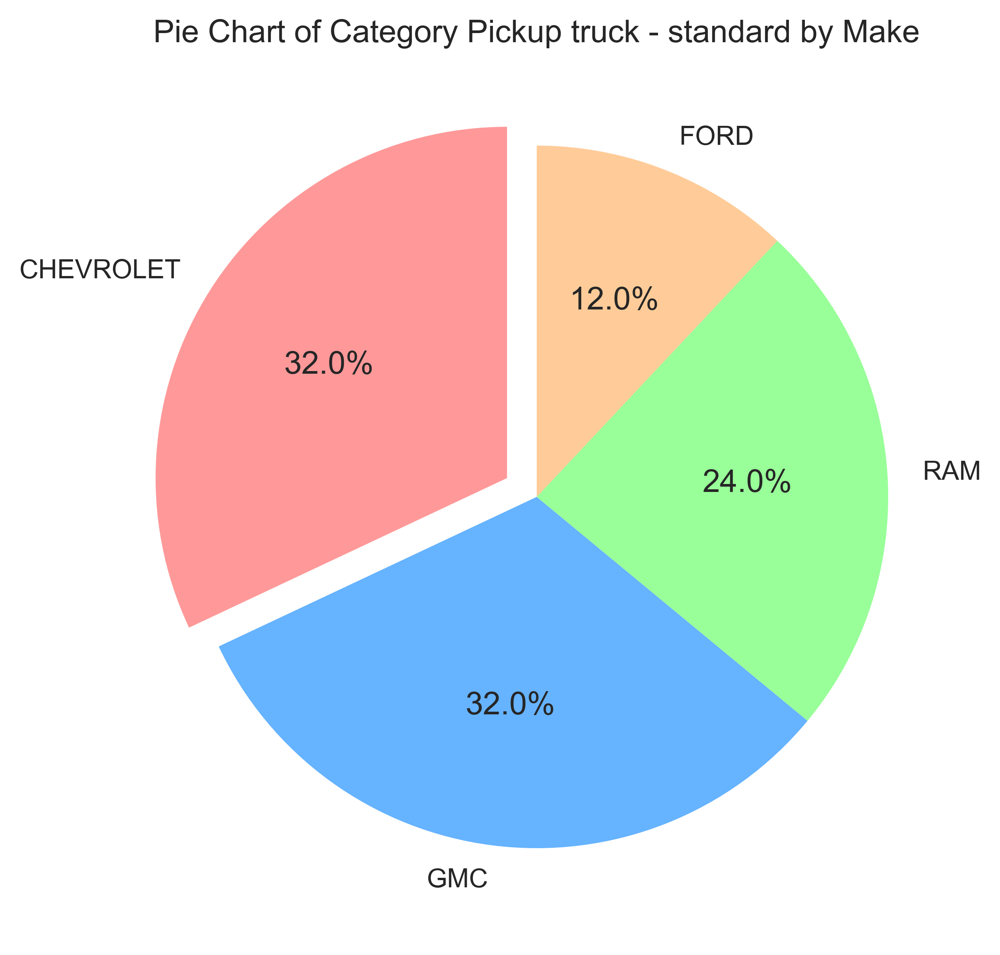

In [83]:
# นับความถี่ของแต่ละ Category
truck_plot = truck['Make'].value_counts()
color_template2 = ['#FF9999', '#66B3FF', '#99FF99', '#FFCC99', '#C0C0C0']


# Plot pie chart
plt.figure(figsize=(8, 6))
truck_plot.plot.pie(
    autopct='%1.1f%%',  # แสดงเปอร์เซ็นต์ในแต่ละส่วน
    startangle=90,      # หมุนให้เริ่มจากมุม 90 องศา
    colors=color_template2[:len(truck_plot)],  # กำหนดสี
    labels=truck_plot.index,  # กำหนด label เป็นชื่อ Category
    explode=[0.1 if i == truck_plot.idxmax() else 0 for i in truck_plot.index],  # แยกส่วนที่ค่ามากที่สุด
)
plt.title('Pie Chart of Category Pickup truck - standard by Make')
plt.ylabel('')  # ลบ label แกน Y
plt.show()

In [84]:
check_less_in_less = data_k_less[data_k_less["CO2_Group"] == "Low CO2"]
check_less_in_less.head(2)

,Make,Model,Vehicle Class,Engine Size(L),Cylinders,Transmission,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km),Make_Encoded,Cluster,CO2_Group
145,BUICK,LACROSSE,MID-SIZE,3.6,6,AS6,E,18.4,12.2,15.6,18,250,0,0,Low CO2
147,BUICK,LACROSSE AWD,MID-SIZE,3.6,6,AS6,E,19.4,13.0,16.5,17,264,0,0,Low CO2


In [85]:
check_less_plot = check_less_in_less[[
    "Make", "Vehicle Class", "Fuel Type", 
    "Fuel Consumption Comb (L/100 km)", "CO2 Emissions(g/km)", "CO2_Group"
]]

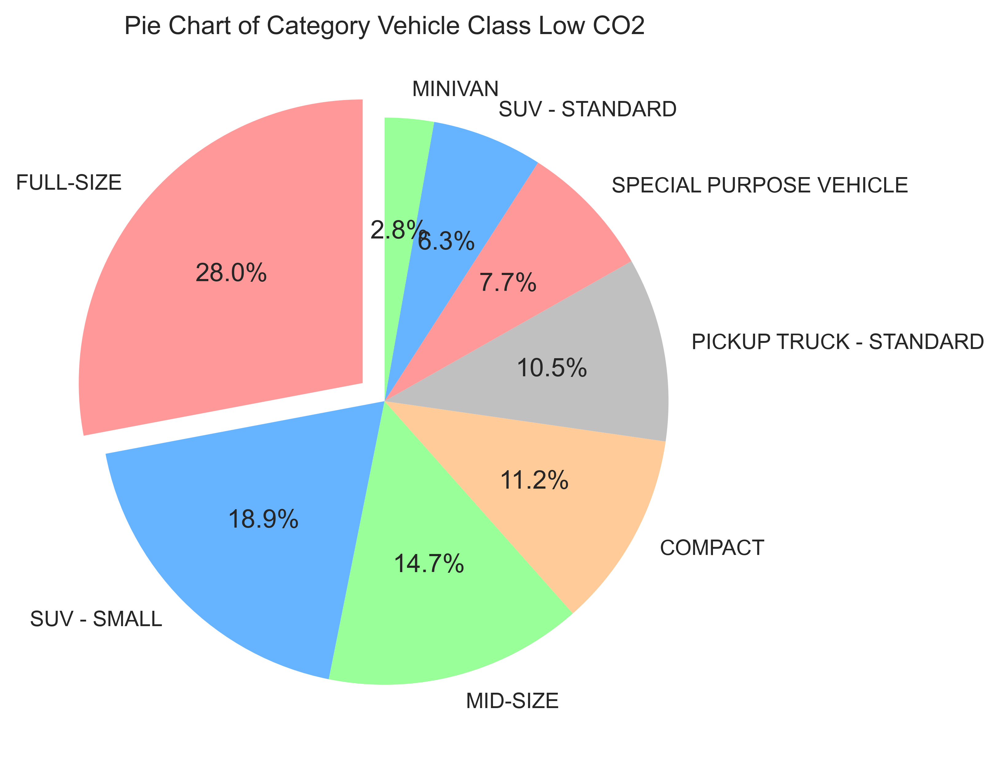

In [86]:
# นับความถี่ของแต่ละ Category
value_counts_v2 = check_less_plot['Vehicle Class'].value_counts()
color_template3 = ['#FF9999', '#66B3FF', '#99FF99', '#FFCC99', '#C0C0C0']


# Plot pie chart
plt.figure(figsize=(8, 6))
value_counts_v2.plot.pie(
    autopct='%1.1f%%',  # แสดงเปอร์เซ็นต์ในแต่ละส่วน
    startangle=90,      # หมุนให้เริ่มจากมุม 90 องศา
    colors=color_template3[:len(value_counts_v2)],  # กำหนดสี
    labels=value_counts_v2.index,  # กำหนด label เป็นชื่อ Category
    explode=[0.1 if i == value_counts_v2.idxmax() else 0 for i in value_counts_v2.index],  # แยกส่วนที่ค่ามากที่สุด
)
plt.title('Pie Chart of Category Vehicle Class Low CO2')
plt.ylabel('')  # ลบ label แกน Y
plt.show()

In [87]:
truck2 = check_less_plot[check_less_plot["Vehicle Class"] == "PICKUP TRUCK - STANDARD"]

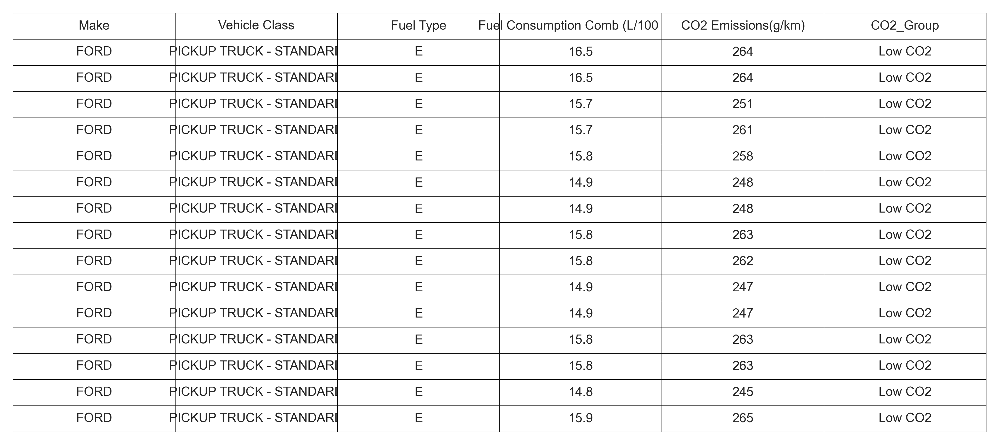

In [88]:
fig, ax = plt.subplots(figsize=(8, 4))  # สร้าง subplot
ax.axis('tight')  # ทำให้กราฟไม่มี axis
ax.axis('off')    # ปิดการแสดง axis

# สร้างตาราง
table_data = truck2.values.tolist()  # แปลง DataFrame เป็น list
column_labels = truck2.columns.tolist()  # หาชื่อคอลัมน์
table = ax.table(cellText=table_data, colLabels=column_labels, cellLoc='center', loc='center')

# ปรับแต่งตาราง
table.auto_set_font_size(False)
table.set_fontsize(7)
table.scale(1.2, 1.2)  # ปรับขนาดตาราง

# เพิ่ม legend ด้วยการใช้ plt.text
# plt.text(0.3, 0.1, 'IONIQ Blue = 57.211544\nIONIQ BLUE = 57.211544\nIONIQ = 50.634093', 
#          ha='center', va='top', fontsize=10, transform=fig.transFigure)

# plt.text(0.7, 0.1, 'CO2 Emissions (g/km) min = 96\nCO2 Emissions (g/km) max = 552 \nCO2 Emissions (g/km) mean= 250.58', 
#          ha='center', va='top', fontsize=10, transform=fig.transFigure)

# plt.title('CO2 Emissions by Model')
plt.show()

In [89]:
chv = check_high_in_less[(check_high_in_less["Make"] == "CHEVROLET") & (check_high_in_less["Vehicle Class"] == "PICKUP TRUCK - STANDARD")]
ford = check_less_in_less[(check_less_in_less["Make"] == "FORD") & (check_less_in_less["Vehicle Class"] == "PICKUP TRUCK - STANDARD")]

In [90]:
mix_chv_ford = pd.concat([chv, ford])

In [91]:
mix_chv_ford = mix_chv_ford.drop(["Fuel Consumption City (L/100 km)", "Fuel Consumption Hwy (L/100 km)", "Fuel Consumption Comb (mpg)", "Make_Encoded", "Cluster"], axis=1)

In [92]:
mix_chv_ford['Vehicle Class'] = mix_chv_ford['Vehicle Class'].replace('PICKUP TRUCK - STANDARD', 'PICKUP TRUCK')

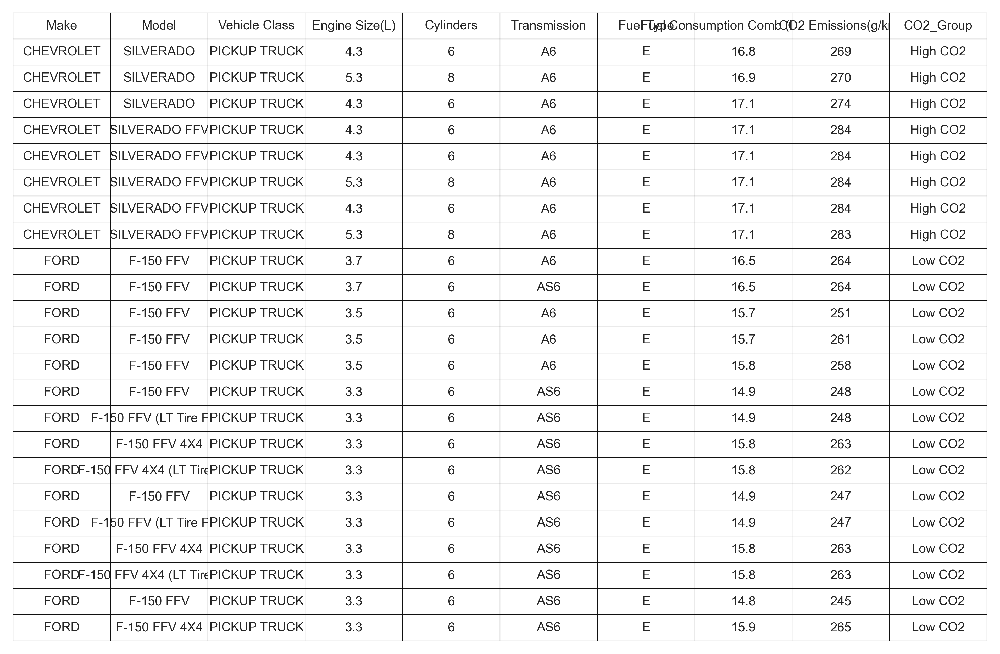

In [93]:
fig, ax = plt.subplots(figsize=(8, 4))  # สร้าง subplot
ax.axis('tight')  # ทำให้กราฟไม่มี axis
ax.axis('off')    # ปิดการแสดง axis

# สร้างตาราง
table_data = mix_chv_ford.values.tolist()  # แปลง DataFrame เป็น list
column_labels = mix_chv_ford.columns.tolist()  # หาชื่อคอลัมน์
table = ax.table(cellText=table_data, colLabels=column_labels, cellLoc='center', loc='center')

# ปรับแต่งตาราง
table.auto_set_font_size(False)
table.set_fontsize(7)
table.scale(1.2, 1.2)  # ปรับขนาดตาราง

plt.show()

In [94]:
data_z = df[df["Fuel Type"] == "Z"]
data_z

,Make,Model,Vehicle Class,Engine Size(L),Cylinders,Transmission,Fuel Type,Fuel Consumption City (L/100 km),Fuel Consumption Hwy (L/100 km),Fuel Consumption Comb (L/100 km),Fuel Consumption Comb (mpg),CO2 Emissions(g/km)
0,ACURA,ILX,COMPACT,2.0,4,AS5,Z,9.9,6.7,8.5,33,196
1,ACURA,ILX,COMPACT,2.4,4,M6,Z,11.2,7.7,9.6,29,221
2,ACURA,ILX HYBRID,COMPACT,1.5,4,AV7,Z,6.0,5.8,5.9,48,136
3,ACURA,MDX 4WD,SUV - SMALL,3.5,6,AS6,Z,12.7,9.1,11.1,25,255
4,ACURA,RDX AWD,SUV - SMALL,3.5,6,AS6,Z,12.1,8.7,10.6,27,244
...,...,...,...,...,...,...,...,...,...,...,...,...
7380,VOLVO,XC40 T5 AWD,SUV - SMALL,2.0,4,AS8,Z,10.7,7.7,9.4,30,219
7381,VOLVO,XC60 T5 AWD,SUV - SMALL,2.0,4,AS8,Z,11.2,8.3,9.9,29,232
7382,VOLVO,XC60 T6 AWD,SUV - SMALL,2.0,4,AS8,Z,11.7,8.6,10.3,27,240
7383,VOLVO,XC90 T5 AWD,SUV - STANDARD,2.0,4,AS8,Z,11.2,8.3,9.9,29,232


In [95]:
truck_z = data_z[data_z['Vehicle Class'] == "PICKUP TRUCK - STANDARD"]
chv_z = truck_z[truck_z['Make'] == "CHEVROLET"]

In [96]:
mix_truck_ez = pd.concat([chv, chv_z])
mix_truck_ez = mix_truck_ez.drop(["Fuel Consumption City (L/100 km)", "Fuel Consumption Hwy (L/100 km)", "Fuel Consumption Comb (mpg)", "Make_Encoded", "Cluster"], axis=1)

In [97]:
mix_truck_ez['Vehicle Class'] = mix_truck_ez['Vehicle Class'].replace('PICKUP TRUCK - STANDARD', 'PICKUP TRUCK')

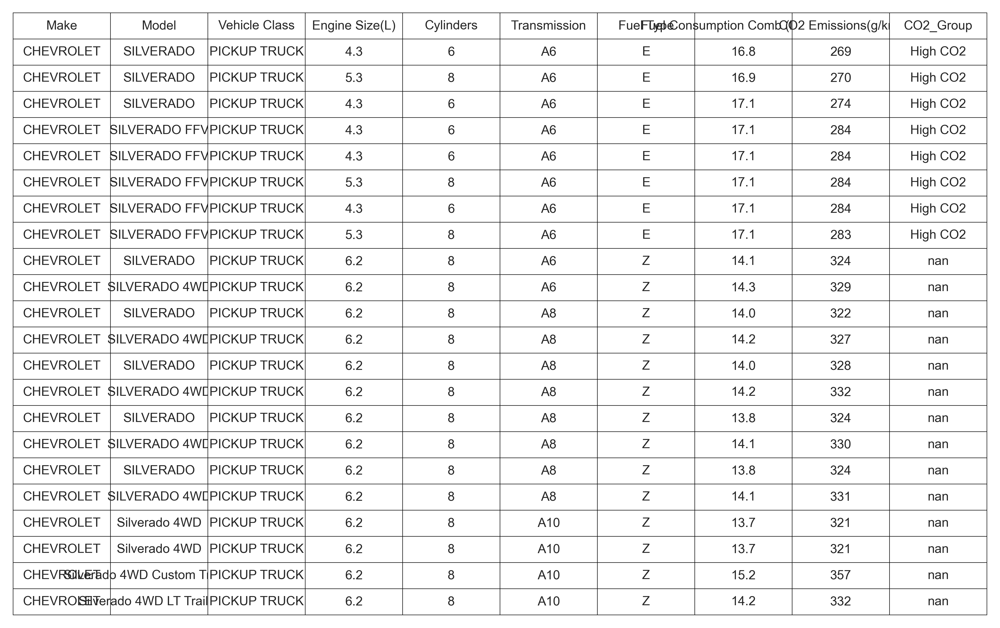

In [98]:
fig, ax = plt.subplots(figsize=(8, 4))  
ax.axis('tight')  
ax.axis('off')    

table_data = mix_truck_ez.values.tolist()  
column_labels = mix_truck_ez.columns.tolist()  
table = ax.table(cellText=table_data, colLabels=column_labels, cellLoc='center', loc='center')

table.auto_set_font_size(False)
table.set_fontsize(7)
table.scale(1.2, 1.2)  

plt.show()

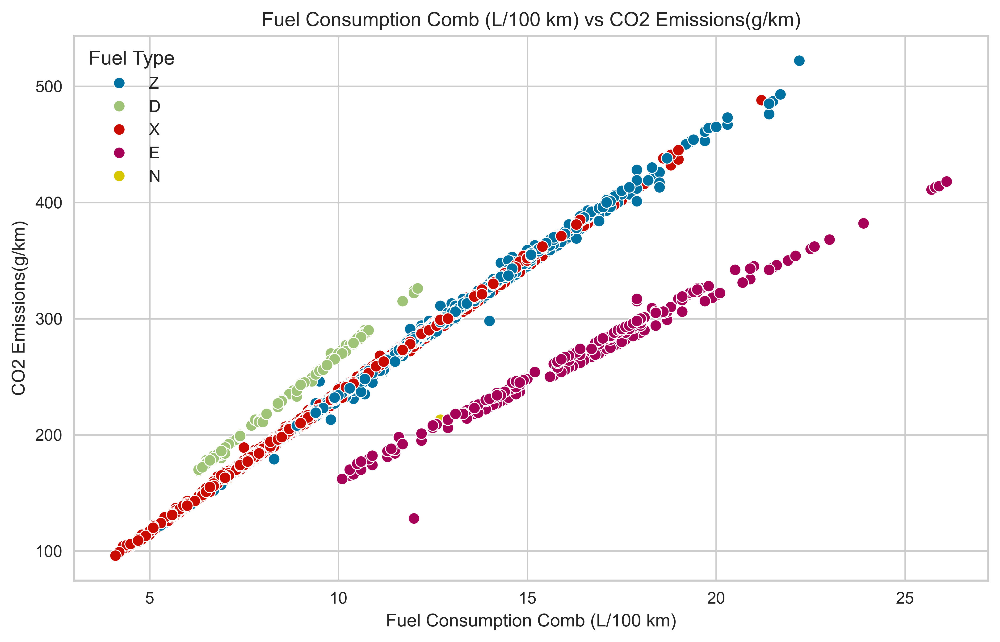

In [99]:
fig, axs = plt.subplots(1, 1, figsize=(10, 6))

sns.scatterplot(x='Fuel Consumption Comb (L/100 km)', 
                y='CO2 Emissions(g/km)', 
                hue='Fuel Type', 
                data=df, 
                ax=axs)

axs.set_title('Fuel Consumption Comb (L/100 km) vs CO2 Emissions(g/km)')
plt.show()

New Scenario

In [100]:
df5 = df3.copy()

X_sc = df5.drop(columns=['CO2 Emissions(g/km)'], axis=1)
y_sc = df5['CO2 Emissions(g/km)']

In [101]:
X_train_sc, X_test_sc, y_train_sc, y_test_sc = train_test_split(X_sc, y_sc, test_size=0.4, random_state=0)

In [102]:
knn_pipeline.fit(X_train_sc, y_train_sc)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['Engine Size(L)',
                                                   'Cylinders',
                                                   'Fuel Consumption City '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Hwy '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(L/100 km)',
                                                   'Fuel Consumption Comb '
                                                   '(mpg)']),
                                                 ('cy', OrdinalEncoder(),
                                                  ['Cylinders']),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['Fuel Type'])])),
                ('knn', KNeighborsRegressor())])

In [103]:
X_scenario = X_sc.copy()
X_scenario['Fuel Type'] = 'E'

In [104]:
# ทำนาย CO2 Emissions สำหรับสถานการณ์ใหม่
scenario_predictions = knn_pipeline.predict(X_scenario)
df5['Predicted CO2 (All E)'] = scenario_predictions

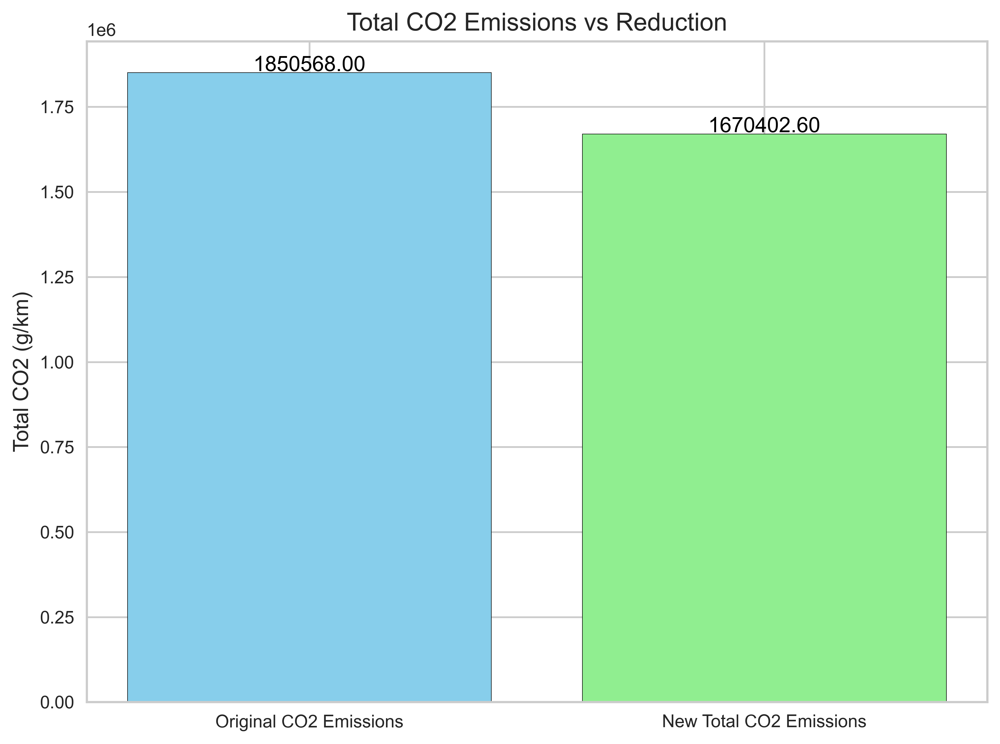

In [105]:
# คำนวณค่าผลรวมของ CO2 Emissions เดิมและ Reduction
total_emissions = df5['CO2 Emissions(g/km)'].sum()  # ผลรวม CO2 Emissions เดิม
total_reduction = df5['Predicted CO2 (All E)'].sum()     # ผลรวม CO2 Reduction

# เตรียมข้อมูลสำหรับ Bar Plot
categories = ['Original CO2 Emissions', 'New Total CO2 Emissions']
values = [total_emissions, total_reduction]

# Plot Bar Graph
plt.figure(figsize=(8, 6))
plt.bar(categories, values, color=['skyblue', 'lightgreen'], edgecolor='black')

# กำหนดชื่อกราฟและแกน
plt.title('Total CO2 Emissions vs Reduction', fontsize=14)
plt.ylabel('Total CO2 (g/km)', fontsize=12)

# เพิ่มตัวเลขบนแท่ง
for i, val in enumerate(values):
    plt.text(i, val + 5000, f'{val:.2f}', ha='center', fontsize=12, color='black')

# แสดงกราฟ
plt.tight_layout()
plt.show()

In [106]:
df5['Reduction (g/km)'] = df5['CO2 Emissions(g/km)'] - df5['Predicted CO2 (All E)']
total_reduction = df5['Reduction (g/km)'].sum()
print(f"Total CO2 Reduction (g/km): {total_reduction:.2f}")

Total CO2 Reduction (g/km): 180165.40


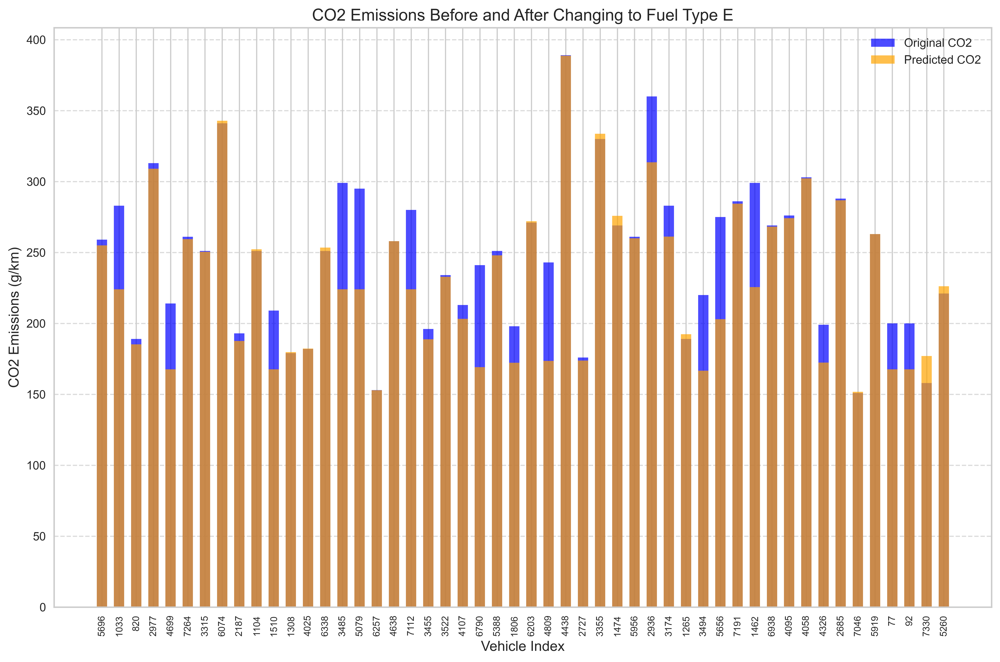

In [112]:
gta = df5.sample(50)

plt.figure(figsize=(12, 8))
bar_width = 0.6
index = range(len(gta))

plt.bar(index, gta['CO2 Emissions(g/km)'], width=bar_width, label='Original CO2', alpha=0.7, color='blue')
plt.bar(index, gta['Predicted CO2 (All E)'], width=bar_width, label='Predicted CO2', alpha=0.7, color='orange')

plt.xlabel('Vehicle Index', fontsize=12)
plt.ylabel('CO2 Emissions (g/km)', fontsize=12)
plt.title('CO2 Emissions Before and After Changing to Fuel Type E', fontsize=14)
plt.xticks(
    index,  # ใช้ index ตามลำดับข้อมูลเดิม
    gta.index,
    rotation=90,
    fontsize=8  # ลดขนาดฟอนต์เพื่อให้พอดีกับกราฟ
)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(fontsize=10)
plt.tight_layout()  # ปรับให้ไม่โดนตัด
plt.show()


In [107]:
# จำนวนรถยนต์ทั้งหมด
num_vehicles = len(df5)

# คำนวณค่าเฉลี่ย CO2 Reduction ต่อคัน
average_co2_reduction_per_vehicle = total_reduction / num_vehicles
print(f"Average CO2 Reduction per vehicle (g/km): {average_co2_reduction_per_vehicle:.2f}")

# เปรียบเทียบกับค่า CO2 Emissions เดิม
average_co2_emissions = df5['CO2 Emissions(g/km)'].mean()
print(f"Average CO2 Emissions (g/km): {average_co2_emissions:.2f}")

# เปอร์เซ็นต์การลด CO2 เทียบกับค่า CO2 Emissions เฉลี่ย
percentage_reduction = (average_co2_reduction_per_vehicle / average_co2_emissions) * 100
print(f"Percentage Reduction in CO2 Emissions: {percentage_reduction:.2f}%")

Average CO2 Reduction per vehicle (g/km): 24.40
Average CO2 Emissions (g/km): 250.58
Percentage Reduction in CO2 Emissions: 9.74%


In [110]:
# ทำนายผลบน Test Set
y_pred = knn_pipeline.predict(X_test_sc)
knn2_r2 = knn_pipeline.score(X_test_sc, y_test_sc)
knn2_mae = mean_absolute_error(y_test_sc, y_pred)
knn2_mse = mean_squared_error(y_test_sc, y_pred)
knn2_rmse = np.sqrt(mean_squared_error(y_test_sc, y_pred))

print(f'Acc: {knn2_r2}')
print(f"Mean Absolute Error: {knn2_mae:.2f}")
print(f'Mean Square Error: {knn2_mse:.2f}')
print(f'Root Mean Square Eroor: {knn2_rmse:.2f}')

Acc: 0.9949143889753886
Mean Absolute Error: 2.52
Mean Square Error: 17.65
Root Mean Square Eroor: 4.20


In [108]:
# ใช้ cross-validation เพื่อคำนวณ SE
knn2cross_val_scores = cross_val_score(knn_pipeline, X_train_sc, y_train_sc, cv=5)

# คำนวณ SE จากค่าเบี่ยงเบนมาตรฐานของคะแนน cross-validation
knn2_se = np.std(knn2cross_val_scores)
print("Standard Error of the model:", knn2_se)

Standard Error of the model: 0.001503321553474121


In [109]:
knn2_train = knn_pipeline.predict(X_train_sc)
knn2_test = knn_pipeline.predict(X_test_sc)

knn2_mse_train = mean_squared_error(y_train_sc, knn2_train)
knn2_mse_test = mean_squared_error(y_test_sc, knn2_test)

knn2_mse_train, knn2_mse_test

(9.51791469194313, 17.64659444820582)

Model Evaluted

1. Feature Selection by Lasso Regression

In [111]:
print(f'R2 score: {lasso_fea_r2:.5f}')
print(f'MAE: {lasso_fea_mae:.2f}')
print(f'MSE: {lasso_fea_mse:.2f}')
print(f'RMSE: {np.sqrt(lasso_fea_mse):.2f}')
print(f'Bias: {lasso_model.intercept_:.2f}')
print(f'SE: {lasso_se}')
print(f'---overfit checking---')
print(f'MSE train: {lasso_mse_train:.2f}')
print(f'MSE Test: {lasso_mse_test:.2f}')

R2 score: 0.99109
MAE: 3.27
MSE: 30.66
RMSE: 5.54
Bias: 255.46
SE: 0.001329217463972145
---overfit checking---
MSE train: 25.29
MSE Test: 30.66


2. Linear Regression

In [112]:
print(f'R2 score: {linear_r2:.5f}')
print(f'MAE: {linear_mae:.2f}')
print(f'MSE: {linear_mse:.2f}')
print(f'RMSE: {linear_rmse:.2f}')
print(f'Bias: {linear_model_bias.intercept_}')
print(f'SE: {linear_se}')
print('---overfit checking---')
print(f'MSE train: {linear_mse_train:.2f}')
print(f'MSE test: {linear_mse_test:.2f}')

R2 score: 0.98611
MAE: 3.18
MSE: 47.78
RMSE: 6.91
Bias: 0.0
SE: 0.0013017805502864657
---overfit checking---
MSE train: 23.97
MSE test: 47.78


3. KNN Regressor Data

In [113]:
print(f'R2 score: {knn_r2}')
print(f'MAE: {knn_mae:.2f}')
print(f'MSE: {knn_mse:.2f}')
print(f'RMSE: {knn_mse:.2f}')
print(f'SE: {knn1_se}')
print('---overfit checking---')
print(f'MSE train: {knn_mse_train:.2f}')
print(f'MSE test: {knn_mse_test:.2f}')

R2 score: 0.9952264121673654
MAE: 2.38
MSE: 16.42
RMSE: 16.42
SE: 0.0004185152573502226
---overfit checking---
MSE train: 8.26
MSE test: 16.42


3.1 KNN Regressor new scenario

In [114]:
print(f'R2 score: {knn2_r2}')
print(f'MAE: {knn2_mae:.2f}')
print(f'MSE: {knn2_mse:.2f}')
print(f'RMSE: {knn2_mse:.2f}')
print('---overfit checking---')
print(f'MSE train: {knn2_mse_train:.2f}')
print(f'MSE test: {knn2_mse_test:.2f}')
print(f'SE: {knn2_se}')

R2 score: 0.9949143889753886
MAE: 2.52
MSE: 17.65
RMSE: 17.65
---overfit checking---
MSE train: 9.52
MSE test: 17.65
SE: 0.001503321553474121


4. Linear Regression with Polynomial degree2

In [115]:
print(f'R2 score: {linear_poly1_r2:.5f}')
print(f'MAE: {linear_poly1_mae:.2f}')
print(f'MSE: {linear_poly1_mse:.2f}')
print(f'RMSE: {linear_poly1_rmse:.2f}')
print(f'Bias: {poly1_model_bias.intercept_}')
print(f'SE: {linear_poly1}')
print('---overfit checking---')
print(f'MSE train: {poly1_mse_train:.2f}')
print(f'MSE test: {poly1_mse_test:.2f}')

R2 score: 0.98994
MAE: 2.66
MSE: 34.61
RMSE: 5.88
Bias: 0.0
SE: 0.00044545679521569424
---overfit checking---
MSE train: 13.16
MSE test: 34.61


5. K-Means

In [116]:
print(f"Silhouette Score: {silhouette_avg:.2f}")

Silhouette Score: 0.54
